# Import Libraries

In [33]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
import tensorflow as tf
from pathlib import Path
import cv2
import time
import random
from PIL import Image 

import torch
import torch.nn as nn
import torch.optim as optim

from torch.optim import lr_scheduler
import torchvision
from torchvision import datasets, transforms

from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import train_test_split

from sklearn.utils.class_weight import compute_class_weight
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.utils import to_categorical

from tensorflow.keras.applications import VGG16
from tensorflow.keras.applications import VGG19
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.applications import ResNet101
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.applications import InceptionResNetV2

from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.vgg16 import preprocess_input, decode_predictions
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Flatten, Dense, Activation, Dropout, BatchNormalization
from tensorflow.keras.optimizers import Adam

from sklearn.metrics import confusion_matrix,classification_report,accuracy_score
from sklearn.metrics import confusion_matrix, precision_score, recall_score, f1_score
from sklearn.metrics import matthews_corrcoef, cohen_kappa_score
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

print("All Libraries Imported Successfully")

All Libraries Imported Successfully


In [34]:
image_dir = Path('/kaggle/input/diabetic-retinopathy-224x224-2019-data')

filepaths = list(image_dir.glob(r'**/*.png'))
labels = list(map(lambda x: os.path.split(os.path.split(x)[0])[1], filepaths))

In [35]:
filepaths = pd.Series(filepaths, name='Filepath').astype(str)
labels = pd.Series(labels, name='Label')

image_df = pd.concat([filepaths, labels], axis=1)

image_df = image_df.sample(frac=1).reset_index(drop = True)

image_df.head()

,Filepath,Label
0,/kaggle/input/diabetic-retinopathy-224x224-201...,Mild
1,/kaggle/input/diabetic-retinopathy-224x224-201...,No_DR
2,/kaggle/input/diabetic-retinopathy-224x224-201...,No_DR
3,/kaggle/input/diabetic-retinopathy-224x224-201...,Moderate
4,/kaggle/input/diabetic-retinopathy-224x224-201...,Mild


In [36]:
image_df.count()

Filepath    3662
Label       3662
dtype: int64

In [37]:
filepaths

0       /kaggle/input/diabetic-retinopathy-224x224-201...
1       /kaggle/input/diabetic-retinopathy-224x224-201...
2       /kaggle/input/diabetic-retinopathy-224x224-201...
3       /kaggle/input/diabetic-retinopathy-224x224-201...
4       /kaggle/input/diabetic-retinopathy-224x224-201...
                              ...                        
3657    /kaggle/input/diabetic-retinopathy-224x224-201...
3658    /kaggle/input/diabetic-retinopathy-224x224-201...
3659    /kaggle/input/diabetic-retinopathy-224x224-201...
3660    /kaggle/input/diabetic-retinopathy-224x224-201...
3661    /kaggle/input/diabetic-retinopathy-224x224-201...
Name: Filepath, Length: 3662, dtype: object

In [38]:
import cv2
import os
import pandas as pd
from pathlib import Path

# Define paths
original_image_dir = Path('/kaggle/input/diabetic-retinopathy-224x224-2019-data')
preprocessed_image_dir = Path('/kaggle/working/Preprocessed_Images')

# Create the output directory if it doesn't exist
preprocessed_image_dir.mkdir(parents=True, exist_ok=True)

# Get file paths and labels
filepaths = list(original_image_dir.glob(r'**/*.png'))
labels = list(map(lambda x: os.path.split(os.path.split(x)[0])[1], filepaths))

# Create a DataFrame
filepaths_series = pd.Series(filepaths, name='Filepath').astype(str)
labels_series = pd.Series(labels, name='Label')
image_df = pd.concat([filepaths_series, labels_series], axis=1)

# Apply YCbCr filter
for index, row in image_df.iterrows():
    image_path = row['Filepath']
    
    # Read the image
    image = cv2.imread(str(image_path))
    
    # Convert the image from BGR to YCbCr
    ycbcr_image = cv2.cvtColor(image, cv2.COLOR_BGR2YCrCb)
    
    # Save the processed image
    new_image_path = preprocessed_image_dir / Path(image_path).name
    cv2.imwrite(str(new_image_path), ycbcr_image)
    
    # Update the DataFrame with the new file path
    image_df.at[index, 'Filepath'] = str(new_image_path)

# Shuffle the DataFrame
image_df = image_df.sample(frac=1).reset_index(drop=True)

# Display the first few rows of the DataFrame
image_df.head()


,Filepath,Label
0,/kaggle/working/Preprocessed_Images/dd19428c3d...,Mild
1,/kaggle/working/Preprocessed_Images/b05922e7ab...,No_DR
2,/kaggle/working/Preprocessed_Images/79540be951...,Moderate
3,/kaggle/working/Preprocessed_Images/f0a2dc5800...,No_DR
4,/kaggle/working/Preprocessed_Images/d1fb4efb11...,Moderate


In [39]:
image_df.count()

Filepath    3662
Label       3662
dtype: int64

In [40]:
level = []
for i in image_df['Label']:
    if i=='No_DR':
        level.append(0)
    elif i=='Mild':
        level.append(1)
    elif i=='Moderate':
        level.append(2)
    elif i=='Severe':
        level.append(3)
    else:
        level.append(4)
image_df['Level'] = level

In [41]:
image_df.head()

,Filepath,Label,Level
0,/kaggle/working/Preprocessed_Images/dd19428c3d...,Mild,1
1,/kaggle/working/Preprocessed_Images/b05922e7ab...,No_DR,0
2,/kaggle/working/Preprocessed_Images/79540be951...,Moderate,2
3,/kaggle/working/Preprocessed_Images/f0a2dc5800...,No_DR,0
4,/kaggle/working/Preprocessed_Images/d1fb4efb11...,Moderate,2


In [42]:
image_df.count()

Filepath    3662
Label       3662
Level       3662
dtype: int64

In [43]:
level

[1,
 0,
 2,
 0,
 2,
 0,
 2,
 4,
 4,
 0,
 0,
 4,
 1,
 0,
 4,
 0,
 0,
 2,
 2,
 4,
 4,
 0,
 2,
 0,
 3,
 2,
 0,
 3,
 0,
 2,
 0,
 0,
 2,
 0,
 1,
 1,
 0,
 2,
 1,
 2,
 0,
 3,
 0,
 3,
 0,
 0,
 2,
 0,
 2,
 0,
 2,
 0,
 3,
 0,
 2,
 0,
 0,
 2,
 2,
 4,
 0,
 2,
 1,
 0,
 0,
 0,
 0,
 2,
 4,
 0,
 2,
 0,
 2,
 0,
 2,
 0,
 0,
 2,
 2,
 2,
 0,
 2,
 1,
 0,
 0,
 1,
 0,
 0,
 2,
 0,
 2,
 0,
 0,
 0,
 0,
 4,
 0,
 4,
 0,
 3,
 0,
 1,
 2,
 2,
 0,
 1,
 0,
 2,
 0,
 1,
 0,
 1,
 0,
 0,
 0,
 0,
 2,
 0,
 2,
 1,
 2,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 2,
 0,
 0,
 2,
 0,
 0,
 2,
 0,
 0,
 2,
 0,
 2,
 2,
 0,
 0,
 0,
 0,
 0,
 2,
 2,
 2,
 0,
 3,
 0,
 4,
 2,
 1,
 2,
 4,
 3,
 0,
 0,
 0,
 0,
 4,
 0,
 2,
 0,
 0,
 0,
 0,
 0,
 3,
 1,
 0,
 0,
 0,
 2,
 2,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 2,
 0,
 0,
 1,
 0,
 0,
 0,
 2,
 0,
 0,
 0,
 2,
 2,
 0,
 2,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 4,
 0,
 0,
 2,
 2,
 0,
 0,
 1,
 3,
 4,
 0,
 4,
 4,
 0,
 3,
 2,
 2,
 2,
 0,
 0,
 0,
 0,
 2,
 4,
 2,
 0,
 1,
 2,
 2,
 0,
 0,
 0,
 2,
 0,
 3,
 0,
 2,
 0,
 0,
 4,
 0,
 0,
 0,


# EDA

In [44]:
image_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3662 entries, 0 to 3661
Data columns (total 3 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   Filepath  3662 non-null   object
 1   Label     3662 non-null   object
 2   Level     3662 non-null   int64 
dtypes: int64(1), object(2)
memory usage: 86.0+ KB


In [45]:
image_df.describe()

,Level
count,3662.000000
mean,1.126980
std,1.298409
min,0.000000
25%,0.000000
50%,1.000000
75%,2.000000
max,4.000000


In [46]:
print(image_df.dtypes)

Filepath    object
Label       object
Level        int64
dtype: object


In [47]:
image_df1 = image_df.copy()

In [48]:
image_df_encoded = pd.get_dummies(image_df1)

In [49]:
from sklearn.preprocessing import LabelEncoder

label_encoders = {}
for column in image_df1.select_dtypes(include=['object']).columns:
    le = LabelEncoder()
    image_df1[column] = le.fit_transform(image_df1[column])
    label_encoders[column] = le


In [50]:
print(image_df1.corr())

          Filepath     Label     Level
Filepath  1.000000  0.028856 -0.029236
Label     0.028856  1.000000  0.177177
Level    -0.029236  0.177177  1.000000


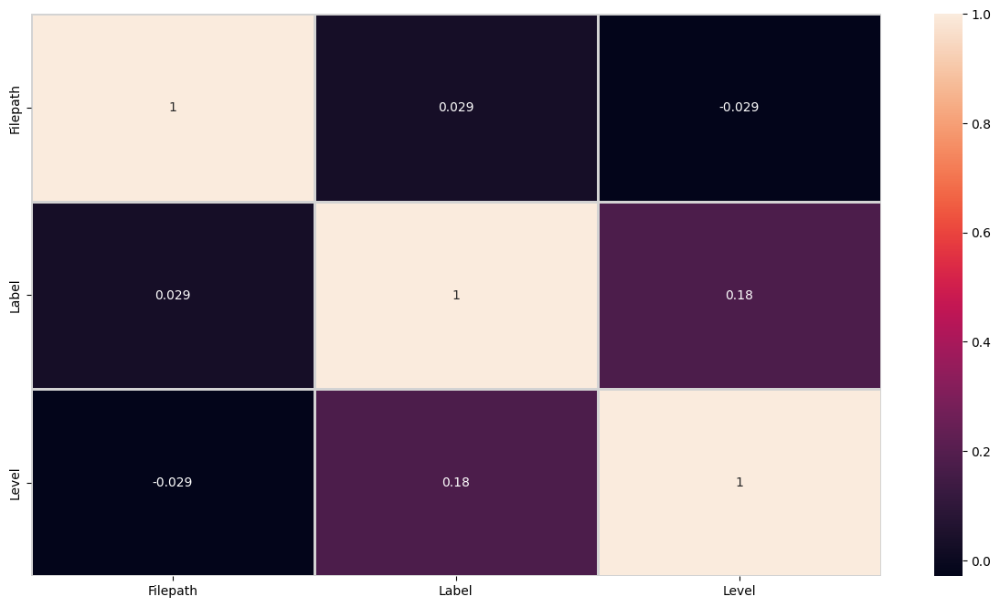

In [51]:
plt.figure(figsize = (15,8))
sns.heatmap(image_df1.corr(), annot=True, linewidth=2, linecolor = 'lightgray')
plt.show()

In [52]:
label_counts = image_df['Level'].value_counts().sort_index()

label_names = {
    0: "NO_DR",
    1: "MILD",
    2: "Moderate",
    3: "Severe",
    4: "Proliferate_DR"
}

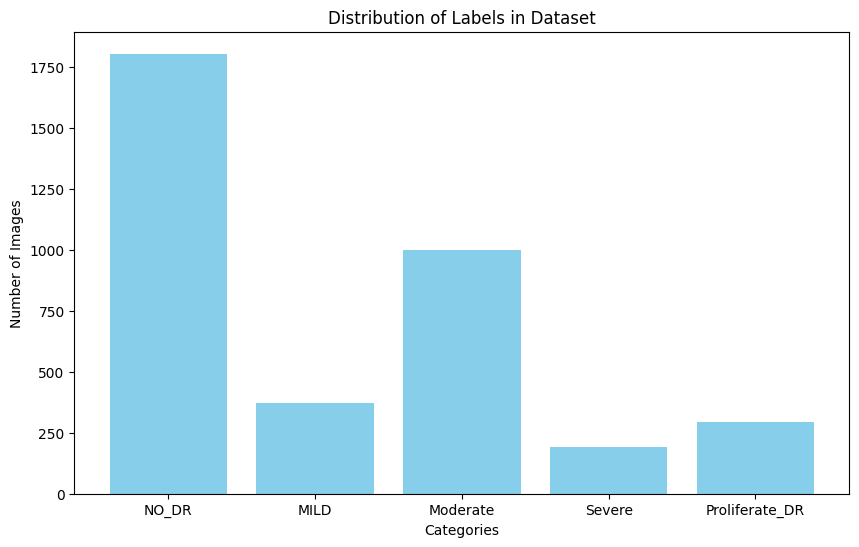

In [53]:
plt.figure(figsize=(10, 6))
plt.bar(label_counts.index, label_counts.values, color='skyblue')

plt.xlabel('Categories')
plt.ylabel('Number of Images')
plt.title('Distribution of Labels in Dataset')
plt.xticks(ticks=list(label_names.keys()), labels=[label_names[i] for i in label_counts.index])


plt.show()

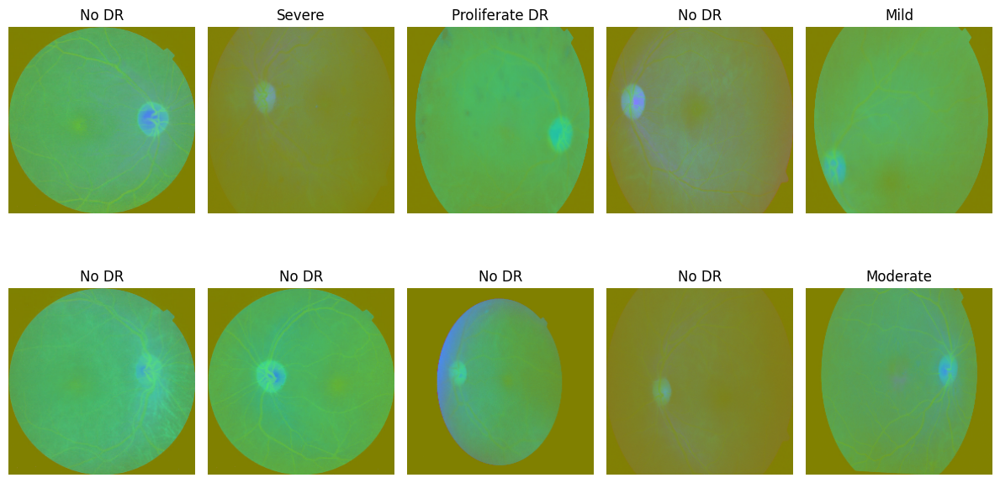

In [55]:
plt.figure(figsize=(12, 7))

for i in range(10):
    sample = random.choice(range(len(image_df)))
    
    # Access the correct columns
    image_path = image_df.iloc[sample]['Filepath']  # Path to image
    category = image_df.iloc[sample]['Level']        # Label

    # Check if image_path is a string
    if not isinstance(image_path, str):
        print(f"Error: Expected image path to be a string, but got {type(image_path)}")
        continue
    
    try:
        # Open and show the image
        image = Image.open(image_path)
    except Exception as e:
        print(f"Error opening image {image_path}: {e}")
        continue

    # Define labels
    label_names = {
        0: "No DR",
        1: "Mild",
        2: "Moderate",
        3: "Severe",
        4: "Proliferate DR"
    }

    label = label_names.get(category, "Unknown")

    plt.subplot(2, 5, i + 1)  
    plt.imshow(image)
    plt.title(label)  # Use title instead of xlabel for clarity
    plt.axis('off')   # Hide axes for better visualization

plt.tight_layout()
plt.show()


# TT SPLIT & DATA AUGMENTATION

In [23]:
import cv2
X = []
for i in image_df['Filepath']:
    image = cv2.imread(i)
    X.append(image)
    
X = np.asarray(X)
y = image_df['Level']
Y = np.asarray(y)

In [24]:
image.shape

(224, 224, 3)

In [25]:
X

array([[[[ 0,  1,  2],
         [ 0,  1,  2],
         [ 0,  1,  2],
         ...,
         [ 0,  1,  2],
         [ 0,  1,  2],
         [ 0,  1,  2]],

        [[ 0,  1,  2],
         [ 0,  1,  2],
         [ 0,  1,  2],
         ...,
         [ 0,  1,  2],
         [ 0,  1,  2],
         [ 0,  1,  2]],

        [[ 0,  1,  2],
         [ 0,  1,  2],
         [ 0,  1,  2],
         ...,
         [ 0,  1,  2],
         [ 0,  1,  3],
         [ 0,  1,  3]],

        ...,

        [[ 1,  1,  1],
         [ 1,  1,  1],
         [ 1,  1,  1],
         ...,
         [ 0,  0,  0],
         [ 0,  0,  0],
         [ 0,  0,  0]],

        [[ 0,  0,  0],
         [ 0,  0,  0],
         [ 0,  0,  0],
         ...,
         [ 0,  0,  0],
         [ 0,  0,  0],
         [ 0,  0,  0]],

        [[ 0,  0,  0],
         [ 0,  0,  0],
         [ 0,  0,  0],
         ...,
         [ 0,  0,  0],
         [ 0,  0,  0],
         [ 0,  0,  0]]],


       [[[13,  8,  9],
         [13,  8,  9],
         [13, 

In [26]:
Y

array([0, 0, 0, ..., 2, 2, 1])

In [27]:
x_train, x_test1, y_train, y_test1 = train_test_split(X, Y, test_size=0.3, random_state=42)
x_val, x_test, y_val, y_test = train_test_split(x_test1, y_test1, test_size=0.3, random_state=42)
print(len(x_train),len(x_val),len(x_test))

2563 769 330


In [28]:
print(x_train.shape)
print(x_val.shape)
print(x_test.shape)

(2563, 224, 224, 3)
(769, 224, 224, 3)
(330, 224, 224, 3)


In [29]:
print(y_train.shape)
print(y_val.shape)
print(y_test.shape)

(2563,)
(769,)
(330,)


In [30]:
idg_train = ImageDataGenerator(
    rescale=1./255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    vertical_flip=False,
    fill_mode='nearest'
)

idg_test = ImageDataGenerator(rescale=1./255)

In [31]:
idg_train.fit(x_train)
idg_train.fit(x_val)
idg_test.fit(x_test)

In [32]:
early_stopping_callback = EarlyStopping(
    monitor='loss',
    patience=15,
    verbose = 1,
    restore_best_weights=True,
    mode = 'min'
)

# VGG16

In [ ]:
vgg16 = VGG16(input_shape=(224,224,3), weights='imagenet', include_top=False)


In [ ]:
for layer in vgg16.layers:
    layer.trainable = False

In [ ]:
flat = Flatten()(vgg16.output)

dense1 = Dense(64, kernel_initializer='he_uniform')(flat)
act1 = Activation('relu')(dense1)

dense2 = Dense(128, kernel_initializer='he_uniform')(act1)
act2 = Activation('relu')(dense2)

dense3 = Dense(256, kernel_initializer='he_uniform')(act2)
act3 = Activation('relu')(dense3)

dense4 = Dense(128, kernel_initializer='he_uniform')(act3)
act4 = Activation('relu')(dense4)

dense5 = Dense(64, kernel_initializer='he_uniform')(act4)
act5 = Activation('relu')(dense5)

output = Dense(5, activation='softmax')(act5)

In [ ]:
final_vgg16 = Model(inputs=vgg16.input,outputs=output)

In [37]:
final_vgg16.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv1 (Conv2D)           │ (None, 224, 224, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, 224, 224, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, 112, 112, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, 112, 112, 128)  │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 (Conv2D)           │ (None, 112, 112, 128)  │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool (MaxPooling2D)      │ (None, 56, 56, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 (Conv2D)           │ (None, 56, 56, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv2 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv3 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_pool (MaxPooling2D)      │ (None, 28, 28, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv1 (Conv2D)           │ (None, 28, 28, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv2 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv3 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_pool (MaxPooling2D)      │ (None, 14, 14, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv1 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv2 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv3 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_pool (MaxPooling2D)      │ (None, 7, 7, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 25088)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 64)             │     1,605,696 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation (Activation)         │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 128)            │         8,320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_1 (Activation)       │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 256)            │        33,02

 Total params: 16,403,205 (62.57 MB)

 Trainable params: 1,688,517 (6.44 MB)

 Non-trainable params: 14,714,688 (56.13 MB)

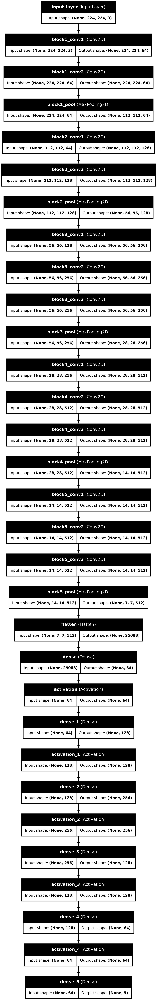

In [38]:
tf.keras.utils.plot_model(final_vgg16, show_shapes = True, show_layer_names=True)

In [ ]:
final_vgg16.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

In [ ]:
history = final_vgg16.fit(
    x_train,                # Training data
    y_train,                # Training labels
    validation_data=(x_val, y_val),  # Validation data and labels
    batch_size=32,
    epochs=30, 
    callbacks=[early_stopping_callback]
)

In [41]:
train_loss, train_accuracy = final_vgg16.evaluate(x_train, y_train, verbose=0)
print(f"Training Accuracy: {train_accuracy * 100:.2f}%")

val_loss, val_accuracy = final_vgg16.evaluate(x_val, y_val, verbose=0)
print(f"Validation Accuracy: {val_accuracy * 100:.2f}%")

test_loss, test_accuracy = final_vgg16.evaluate(x_test, y_test, verbose=0)
print(f"Test Accuracy: {test_accuracy * 100:.2f}%")


Training Accuracy: 98.67%
Validation Accuracy: 76.07%
Test Accuracy: 75.45%


In [42]:
y_pred = []
for i in final_vgg16.predict(x_test):
    y_pred.append(np.argmax(np.array(i)).astype("int32"))

print(y_pred)

11/11 ━━━━━━━━━━━━━━━━━━━━ 2s 162ms/step
[0, 0, 0, 4, 0, 0, 3, 0, 2, 2, 0, 0, 0, 0, 2, 2, 4, 0, 4, 0, 2, 1, 0, 2, 2, 0, 0, 0, 0, 0, 2, 2, 0, 2, 2, 3, 2, 2, 0, 1, 4, 2, 0, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 2, 0, 1, 2, 2, 2, 2, 2, 1, 2, 0, 2, 0, 0, 1, 0, 0, 0, 4, 2, 1, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 2, 4, 0, 0, 0, 0, 2, 0, 2, 2, 2, 4, 1, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0, 0, 1, 2, 1, 0, 0, 0, 2, 0, 0, 0, 0, 0, 2, 1, 1, 1, 0, 2, 2, 0, 1, 0, 0, 1, 0, 0, 2, 0, 2, 1, 0, 1, 4, 0, 0, 2, 0, 0, 0, 0, 0, 2, 4, 0, 0, 2, 0, 0, 0, 2, 0, 0, 0, 2, 2, 0, 2, 0, 0, 2, 2, 1, 2, 2, 2, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 2, 1, 2, 0, 2, 2, 2, 0, 0, 2, 2, 0, 2, 0, 0, 2, 2, 1, 2, 0, 2, 2, 4, 2, 2, 1, 0, 3, 1, 0, 0, 2, 0, 2, 4, 4, 3, 2, 0, 2, 0, 0, 0, 2, 0, 2, 0, 0, 0, 2, 1, 3, 0, 0, 2, 2, 0, 2, 0, 3, 2, 0, 4, 0, 4, 2, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 2, 1, 0, 0, 1, 0, 0, 0, 2, 2, 2, 0, 0, 4, 0, 0, 0, 4, 0, 2, 1, 2, 2, 0, 0, 0, 2, 2, 0, 0, 2, 2, 0, 0, 2, 2, 0, 2, 2, 4, 0, 0, 2, 2, 2, 1, 0, 4, 0

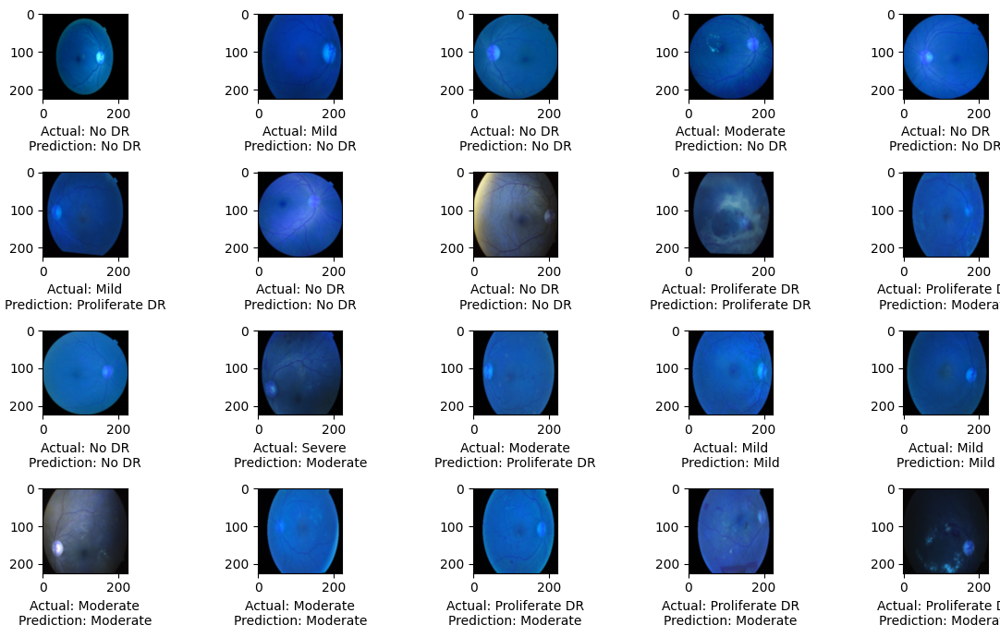

In [43]:
plt.figure(figsize=(12, 7))
for i in range(20):
    sample = random.choice(range(len(x_test)))
    image = x_test[sample]
    category = y_test[sample]
    pred_category = y_pred[sample]

    label_mapping = {
        0: "No DR",
        1: "Mild",
        2: "Moderate",
        3: "Severe",
        4: "Proliferate DR"
    }

    label = label_mapping[category]
    pred_label = label_mapping[pred_category]

    plt.subplot(4, 5, i + 1)
    plt.imshow(image)
    plt.xlabel("Actual: {}\nPrediction: {}".format(label, pred_label))
plt.tight_layout()
plt.show()


In [44]:
final_vgg16.save("DR_VGG16.h5")

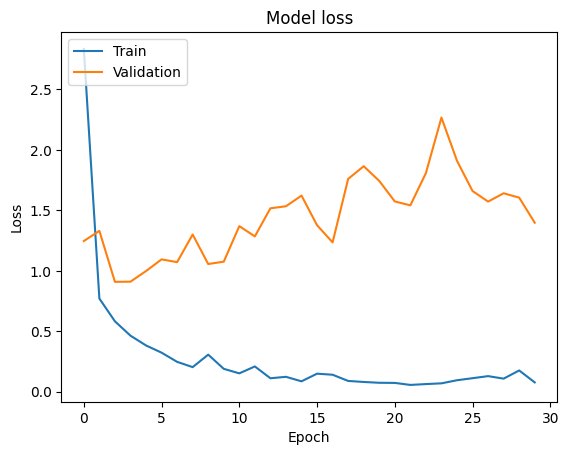

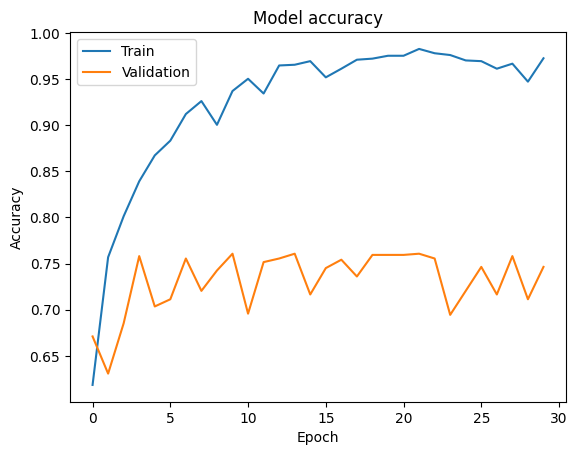

In [45]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()


plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

In [51]:
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score

class_names = ['NO DR', 'MILD', 'MODERATE', 'SEVERE', 'PROLIFERATE']

y_pred = final_vgg16.predict(x_test)

y_pred_classes = np.argmax(y_pred, axis=1)

y_true_classes = y_test

report = classification_report(y_true_classes, y_pred_classes, target_names=class_names)
print(report)


11/11 ━━━━━━━━━━━━━━━━━━━━ 1s 133ms/step
              precision    recall  f1-score   support

       NO DR       0.94      0.95      0.95       168
        MILD       0.59      0.52      0.55        33
    MODERATE       0.56      0.71      0.63        83
      SEVERE       0.29      0.13      0.18        15
 PROLIFERATE       0.58      0.35      0.44        31

    accuracy                           0.75       330
   macro avg       0.59      0.53      0.55       330
weighted avg       0.75      0.75      0.74       330



In [56]:
conf_matrix = confusion_matrix(y_true_classes, y_pred_classes)

# Calculate per-class metrics
precision1 = precision_score(y_true_classes, y_pred_classes, average=None)
recall1 = recall_score(y_true_classes, y_pred_classes, average=None)
f11 = f1_score(y_true_classes, y_pred_classes, average=None)
mcc1 = matthews_corrcoef(y_true_classes, y_pred_classes)
kappa = cohen_kappa_score(y_true_classes, y_pred_classes)

# For specificity, we need to compute it manually
specificity1 = []
for i in range(conf_matrix.shape[0]):
    # True Negatives: sum all elements except the ith row and ith column
    tn = np.sum(np.delete(np.delete(conf_matrix, i, axis=0), i, axis=1))
    # False Positives: sum the ith column except the diagonal
    fp = np.sum(conf_matrix[:, i]) - conf_matrix[i, i]
    # False Negatives: sum the ith row except the diagonal
    fn = np.sum(conf_matrix[i, :]) - conf_matrix[i, i]
    # True Positives: diagonal element
    tp = conf_matrix[i, i]
    specificity1.append(tn / (tn + fp))

print(f"Precision per class: {precision1}")
print(f"Recall per class: {recall1}")
print(f"F1 Score per class: {f11}")
print(f"Specificity per class: {specificity1}")
print(f"Cohen's Kappa Score: {kappa}")
print(f"Matthews Correlation Coefficient (MCC): {mcc1}")

Precision per class: [0.94117647 0.5862069  0.56190476 0.28571429 0.57894737]
Recall per class: [0.95238095 0.51515152 0.71084337 0.13333333 0.35483871]
F1 Score per class: [0.94674556 0.5483871  0.62765957 0.18181818 0.44      ]
Specificity per class: [0.9382716049382716, 0.9595959595959596, 0.8137651821862348, 0.9841269841269841, 0.9732441471571907]
Cohen's Kappa Score: 0.6180009717895218
Matthews Correlation Coefficient (MCC): 0.6213911963330894


In [57]:
print(conf_matrix)

[[160   3   5   0   0]
 [  2  17  13   0   1]
 [  7   9  59   3   5]
 [  0   0  11   2   2]
 [  1   0  17   2  11]]


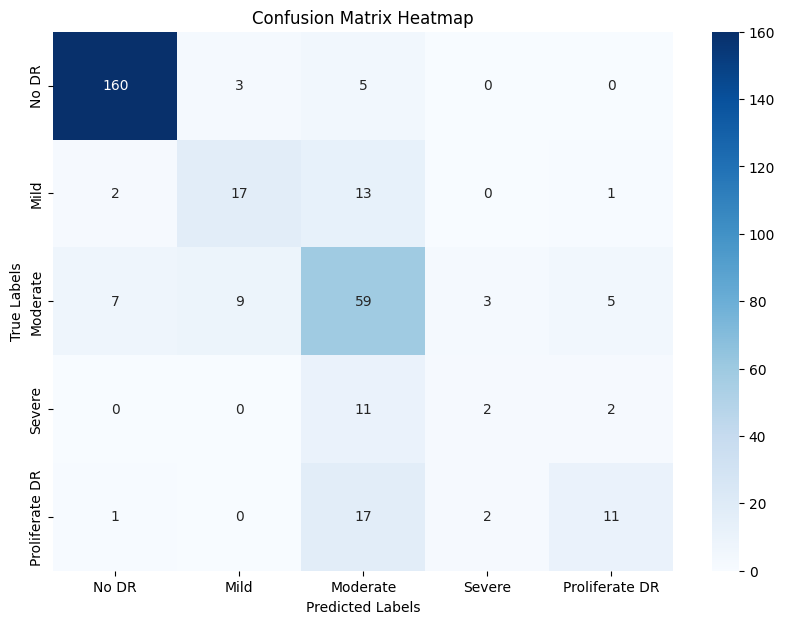

In [58]:
plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', 
            xticklabels=["No DR", "Mild", "Moderate", "Severe", "Proliferate DR"],
            yticklabels=["No DR", "Mild", "Moderate", "Severe", "Proliferate DR"])
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix Heatmap')
plt.show()

In [59]:
tp_list = []
tn_list = []
fp_list = []
fn_list = []

# Iterate over each class index
for i in range(conf_matrix.shape[0]):
    tp = conf_matrix[i, i]
    fp = np.sum(conf_matrix[:, i]) - tp
    fn = np.sum(conf_matrix[i, :]) - tp
    tn = np.sum(conf_matrix) - (tp + fp + fn)

    tp_list.append(tp)
    tn_list.append(tn)
    fp_list.append(fp)
    fn_list.append(fn)

print(f"True Positives per class: {tp_list}")
print(f"True Negatives per class: {tn_list}")
print(f"False Positives per class: {fp_list}")
print(f"False Negatives per class: {fn_list}")

True Positives per class: [160, 17, 59, 2, 11]
True Negatives per class: [152, 285, 201, 310, 291]
False Positives per class: [10, 12, 46, 5, 8]
False Negatives per class: [8, 16, 24, 13, 20]


In [60]:
for layer in final_vgg16.layers:
    output_shape = getattr(layer, 'output_shape', 'N/A')
    print(f"Layer Name: {layer.name}")

Layer Name: input_layer
Layer Name: block1_conv1
Layer Name: block1_conv2
Layer Name: block1_pool
Layer Name: block2_conv1
Layer Name: block2_conv2
Layer Name: block2_pool
Layer Name: block3_conv1
Layer Name: block3_conv2
Layer Name: block3_conv3
Layer Name: block3_pool
Layer Name: block4_conv1
Layer Name: block4_conv2
Layer Name: block4_conv3
Layer Name: block4_pool
Layer Name: block5_conv1
Layer Name: block5_conv2
Layer Name: block5_conv3
Layer Name: block5_pool
Layer Name: flatten
Layer Name: dense
Layer Name: activation
Layer Name: dense_1
Layer Name: activation_1
Layer Name: dense_2
Layer Name: activation_2
Layer Name: dense_3
Layer Name: activation_3
Layer Name: dense_4
Layer Name: activation_4
Layer Name: dense_5


# VGG19

In [61]:
vgg19 = VGG19(input_shape=(224,224,3), weights='imagenet', include_top=False)

80134624/80134624 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step


In [62]:
x = Flatten()(vgg19.output)
dense1 = Dense(64, kernel_initializer='he_uniform')(x)
act1 = Activation('relu')(dense1)

dense2 = Dense(128, kernel_initializer='he_uniform')(act1)
act2 = Activation('relu')(dense2)

dense3 = Dense(256, kernel_initializer='he_uniform')(act2)
act3 = Activation('relu')(dense3)

dense4 = Dense(128, kernel_initializer='he_uniform')(act3)
act4 = Activation('relu')(dense4)

dense5 = Dense(64, kernel_initializer='he_uniform')(act4)
act5 = Activation('relu')(dense5)

predictions = Dense(5, activation='softmax')(act5)

In [64]:
final_vgg19 = Model(inputs=vgg19.input, outputs=predictions)


In [65]:
final_vgg19.summary()

Model: "functional_5"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv1 (Conv2D)           │ (None, 224, 224, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, 224, 224, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, 112, 112, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, 112, 112, 128)  │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 (Conv2D)           │ (None, 112, 112, 128)  │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool (MaxPooling2D)      │ (None, 56, 56, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 (Conv2D)           │ (None, 56, 56, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv2 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv3 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv4 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_pool (MaxPooling2D)      │ (None, 28, 28, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv1 (Conv2D)           │ (None, 28, 28, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv2 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv3 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv4 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_pool (MaxPooling2D)      │ (None, 14, 14, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv1 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv2 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv3 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv4 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_pool (MaxPooling2D)      │ (None, 7, 7, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_1 (Flatten)             │ (None, 25088)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 64)             │     1,605,696 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_5 (Activation)       │ (None, 64)             │             

 Total params: 21,712,901 (82.83 MB)

 Trainable params: 21,712,901 (82.83 MB)

 Non-trainable params: 0 (0.00 B)

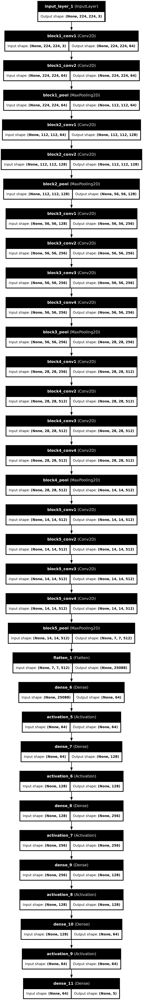

In [66]:
tf.keras.utils.plot_model(final_vgg19, show_shapes = True, show_layer_names=True)

In [67]:
final_vgg19.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

In [68]:
history = final_vgg19.fit(
    x_train,                # Training data
    y_train,                # Training labels
    validation_data=(x_val, y_val),  # Validation data and labels
    batch_size=32,
    epochs=30, 
    callbacks=[early_stopping_callback]
)

Epoch 1/30
81/81 ━━━━━━━━━━━━━━━━━━━━ 0s 551ms/step - accuracy: 0.4494 - loss: 4.7130

I0000 00:00:1725285934.947993      92 asm_compiler.cc:369] ptxas warning : Registers are spilled to local memory in function 'input_reduce_select_fusion_13', 208 bytes spill stores, 208 bytes spill loads
ptxas warning : Registers are spilled to local memory in function 'input_reduce_select_fusion_12', 20 bytes spill stores, 20 bytes spill loads



81/81 ━━━━━━━━━━━━━━━━━━━━ 84s 613ms/step - accuracy: 0.4498 - loss: 4.6831 - val_accuracy: 0.4759 - val_loss: 1.1939
Epoch 2/30
81/81 ━━━━━━━━━━━━━━━━━━━━ 41s 503ms/step - accuracy: 0.6256 - loss: 1.0193 - val_accuracy: 0.6762 - val_loss: 0.9028
Epoch 3/30
81/81 ━━━━━━━━━━━━━━━━━━━━ 40s 495ms/step - accuracy: 0.6989 - loss: 0.8522 - val_accuracy: 0.5852 - val_loss: 0.9234
Epoch 4/30
81/81 ━━━━━━━━━━━━━━━━━━━━ 40s 499ms/step - accuracy: 0.7033 - loss: 0.8332 - val_accuracy: 0.7087 - val_loss: 0.8332
Epoch 5/30
81/81 ━━━━━━━━━━━━━━━━━━━━ 40s 497ms/step - accuracy: 0.6914 - loss: 0.8748 - val_accuracy: 0.6944 - val_loss: 1.0822
Epoch 6/30
81/81 ━━━━━━━━━━━━━━━━━━━━ 40s 493ms/step - accuracy: 0.6092 - loss: 2.9246 - val_accuracy: 0.7048 - val_loss: 0.8796
Epoch 7/30
81/81 ━━━━━━━━━━━━━━━━━━━━ 40s 491ms/step - accuracy: 0.6918 - loss: 0.9060 - val_accuracy: 0.7022 - val_loss: 0.9375
Epoch 8/30
81/81 ━━━━━━━━━━━━━━━━━━━━ 40s 492ms/step - accuracy: 0.6974 - loss: 0.8439 - val_accuracy: 0.704

In [69]:
train_loss, train_accuracy = final_vgg19.evaluate(x_train, y_train, verbose=0)
print(f"Training Accuracy: {train_accuracy * 100:.2f}%")

val_loss, val_accuracy = final_vgg19.evaluate(x_val, y_val, verbose=0)
print(f"Validation Accuracy: {val_accuracy * 100:.2f}%")

test_loss, test_accuracy = final_vgg19.evaluate(x_test, y_test, verbose=0)
print(f"Test Accuracy: {test_accuracy * 100:.2f}%")


Training Accuracy: 49.59%
Validation Accuracy: 47.59%
Test Accuracy: 50.91%


In [73]:
y_pred = []
for i in final_vgg19.predict(x_test):
    y_pred.append(np.argmax(np.array(i)).astype("int32"))

print(y_pred)

11/11 ━━━━━━━━━━━━━━━━━━━━ 1s 143ms/step
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

In [72]:
print(y_test)

[0 0 0 3 0 0 4 0 2 2 0 0 0 1 2 2 4 0 4 0 2 2 0 0 4 0 0 0 0 0 4 1 0 2 4 3 2
 2 4 1 2 4 0 0 4 0 0 0 0 0 2 0 0 0 0 2 0 0 2 0 0 0 3 0 2 4 3 2 2 3 1 0 0 2
 0 0 1 0 0 0 4 2 1 0 0 0 0 0 3 0 4 0 0 2 1 0 0 0 0 2 0 2 2 2 4 2 0 2 0 0 1
 2 4 0 0 0 0 1 2 0 0 0 0 3 0 0 0 0 0 2 1 2 1 0 4 2 0 2 0 0 1 0 0 2 0 1 0 0
 2 4 0 0 4 0 0 0 0 0 2 3 2 0 2 0 0 0 2 0 0 0 2 1 0 3 2 0 4 4 2 2 2 2 0 1 0
 0 0 0 0 0 1 0 0 0 2 1 2 0 2 2 4 0 0 2 3 0 2 0 0 2 2 0 2 0 1 1 4 4 2 1 0 2
 1 2 2 2 0 2 2 4 2 4 0 3 0 0 0 1 0 0 0 0 0 2 1 4 0 0 2 2 0 2 0 3 3 0 4 0 4
 2 0 2 0 0 0 0 0 0 3 2 2 4 1 0 0 1 0 0 0 2 2 2 0 0 2 1 0 0 2 0 2 1 1 0 0 0
 0 2 3 0 0 2 2 0 0 1 1 0 1 4 4 0 0 1 1 0 2 0 4 0 0 0 2 2 2 2 2 0 0 0]


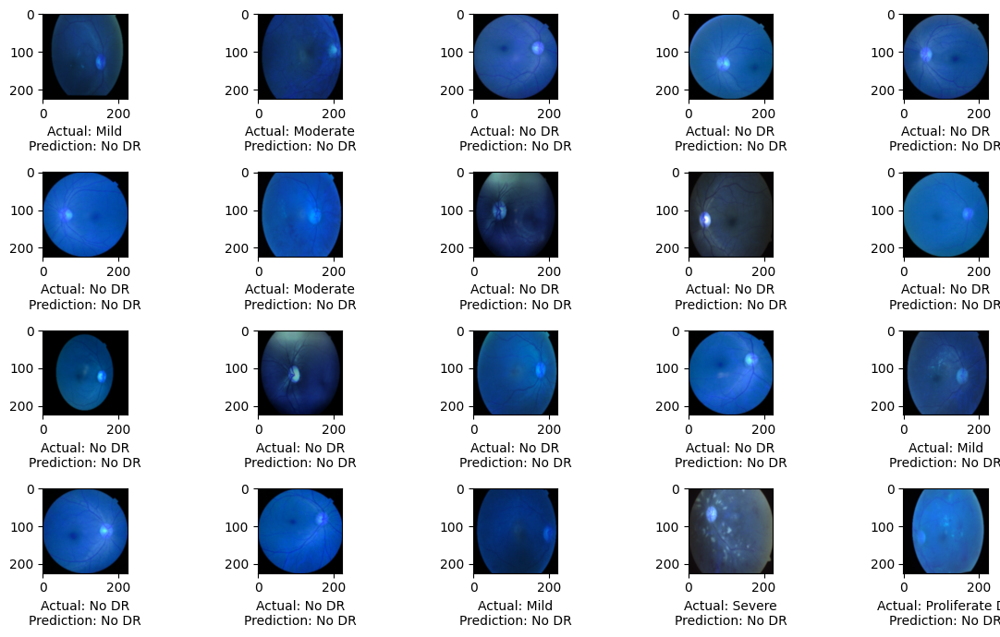

In [71]:
plt.figure(figsize=(12, 7))
for i in range(20):
    sample = random.choice(range(len(x_test)))
    image = x_test[sample]
    category = y_test[sample]
    pred_category = y_pred[sample]

    label_mapping = {
        0: "No DR",
        1: "Mild",
        2: "Moderate",
        3: "Severe",
        4: "Proliferate DR"
    }

    label = label_mapping[category]
    pred_label = label_mapping[pred_category]

    plt.subplot(4, 5, i + 1)
    plt.imshow(image)
    plt.xlabel("Actual: {}\nPrediction: {}".format(label, pred_label))
plt.tight_layout()
plt.show()

In [75]:
final_vgg19.save("DR_VGG19.h5")

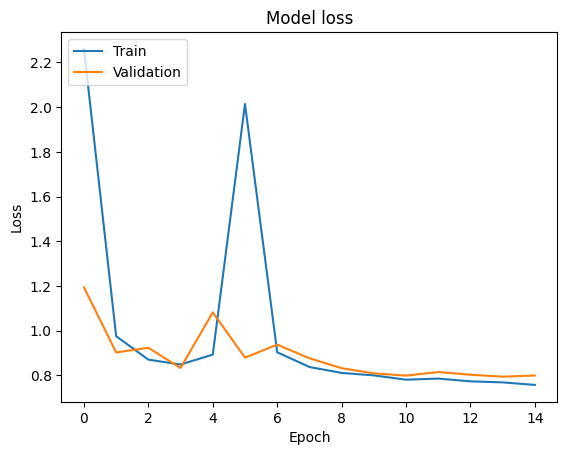

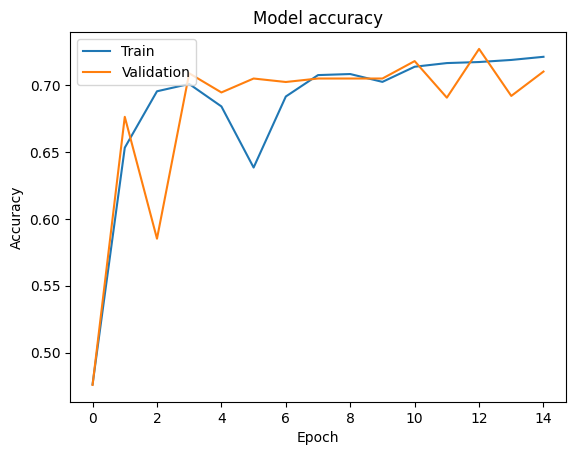

In [76]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()


plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

In [79]:
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score

class_names = ['NO DR', 'MILD', 'MODERATE', 'SEVERE', 'PROLIFERATE']

y_pred = final_vgg19.predict(x_test)

y_pred_classes = np.argmax(y_pred, axis=1)

y_true_classes = y_test

report = classification_report(y_true_classes, y_pred_classes, target_names=class_names)
print(report)


11/11 ━━━━━━━━━━━━━━━━━━━━ 2s 148ms/step
              precision    recall  f1-score   support

       NO DR       0.51      1.00      0.67       168
        MILD       0.00      0.00      0.00        33
    MODERATE       0.00      0.00      0.00        83
      SEVERE       0.00      0.00      0.00        15
 PROLIFERATE       0.00      0.00      0.00        31

    accuracy                           0.51       330
   macro avg       0.10      0.20      0.13       330
weighted avg       0.26      0.51      0.34       330



/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [80]:
conf_matrix = confusion_matrix(y_true_classes, y_pred_classes)

# Calculate per-class metrics
precision1 = precision_score(y_true_classes, y_pred_classes, average=None)
recall1 = recall_score(y_true_classes, y_pred_classes, average=None)
f11 = f1_score(y_true_classes, y_pred_classes, average=None)
mcc1 = matthews_corrcoef(y_true_classes, y_pred_classes)
kappa = cohen_kappa_score(y_true_classes, y_pred_classes)

# For specificity, we need to compute it manually
specificity1 = []
for i in range(conf_matrix.shape[0]):
    # True Negatives: sum all elements except the ith row and ith column
    tn = np.sum(np.delete(np.delete(conf_matrix, i, axis=0), i, axis=1))
    # False Positives: sum the ith column except the diagonal
    fp = np.sum(conf_matrix[:, i]) - conf_matrix[i, i]
    # False Negatives: sum the ith row except the diagonal
    fn = np.sum(conf_matrix[i, :]) - conf_matrix[i, i]
    # True Positives: diagonal element
    tp = conf_matrix[i, i]
    specificity1.append(tn / (tn + fp))

print(f"Precision per class: {precision1}")
print(f"Recall per class: {recall1}")
print(f"F1 Score per class: {f11}")
print(f"Specificity per class: {specificity1}")
print(f"Cohen's Kappa Score: {kappa}")
print(f"Matthews Correlation Coefficient (MCC): {mcc1}")

Precision per class: [0.50909091 0.         0.         0.         0.        ]
Recall per class: [1. 0. 0. 0. 0.]
F1 Score per class: [0.6746988 0.        0.        0.        0.       ]
Specificity per class: [0.0, 1.0, 1.0, 1.0, 1.0]
Cohen's Kappa Score: 0.0
Matthews Correlation Coefficient (MCC): 0.0


/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [81]:
print(conf_matrix)

[[168   0   0   0   0]
 [ 33   0   0   0   0]
 [ 83   0   0   0   0]
 [ 15   0   0   0   0]
 [ 31   0   0   0   0]]


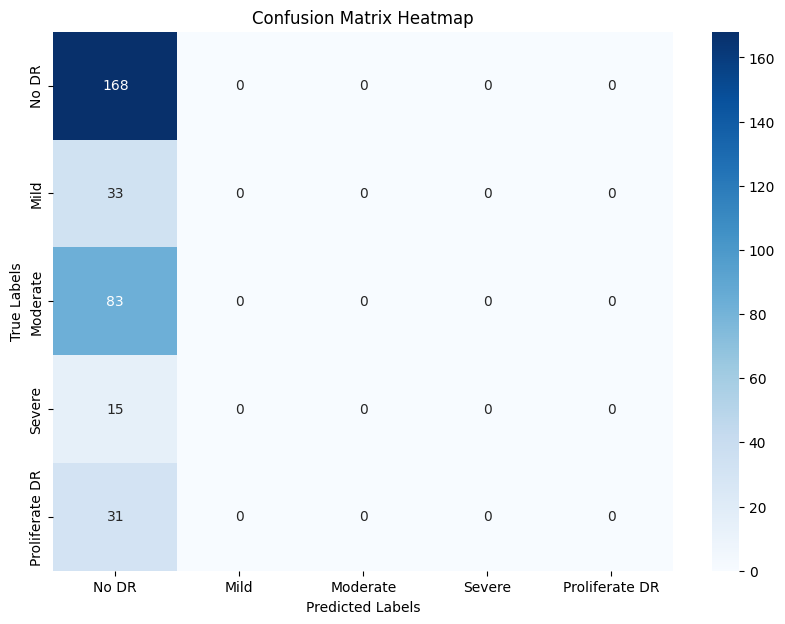

In [82]:
plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', 
            xticklabels=["No DR", "Mild", "Moderate", "Severe", "Proliferate DR"],
            yticklabels=["No DR", "Mild", "Moderate", "Severe", "Proliferate DR"])
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix Heatmap')
plt.show()

In [83]:
tp_list = []
tn_list = []
fp_list = []
fn_list = []

# Iterate over each class index
for i in range(conf_matrix.shape[0]):
    tp = conf_matrix[i, i]
    fp = np.sum(conf_matrix[:, i]) - tp
    fn = np.sum(conf_matrix[i, :]) - tp
    tn = np.sum(conf_matrix) - (tp + fp + fn)

    tp_list.append(tp)
    tn_list.append(tn)
    fp_list.append(fp)
    fn_list.append(fn)

print(f"True Positives per class: {tp_list}")
print(f"True Negatives per class: {tn_list}")
print(f"False Positives per class: {fp_list}")
print(f"False Negatives per class: {fn_list}")

True Positives per class: [168, 0, 0, 0, 0]
True Negatives per class: [0, 297, 247, 315, 299]
False Positives per class: [162, 0, 0, 0, 0]
False Negatives per class: [0, 33, 83, 15, 31]


In [84]:
for layer in final_vgg19.layers:
    output_shape = getattr(layer, 'output_shape', 'N/A')
    print(f"Layer Name: {layer.name}")

Layer Name: input_layer_1
Layer Name: block1_conv1
Layer Name: block1_conv2
Layer Name: block1_pool
Layer Name: block2_conv1
Layer Name: block2_conv2
Layer Name: block2_pool
Layer Name: block3_conv1
Layer Name: block3_conv2
Layer Name: block3_conv3
Layer Name: block3_conv4
Layer Name: block3_pool
Layer Name: block4_conv1
Layer Name: block4_conv2
Layer Name: block4_conv3
Layer Name: block4_conv4
Layer Name: block4_pool
Layer Name: block5_conv1
Layer Name: block5_conv2
Layer Name: block5_conv3
Layer Name: block5_conv4
Layer Name: block5_pool
Layer Name: flatten_1
Layer Name: dense_6
Layer Name: activation_5
Layer Name: dense_7
Layer Name: activation_6
Layer Name: dense_8
Layer Name: activation_7
Layer Name: dense_9
Layer Name: activation_8
Layer Name: dense_10
Layer Name: activation_9
Layer Name: dense_11


# Resnet 50

In [35]:
resnet50 = ResNet50(input_shape=(224,224,3), weights='imagenet', include_top=False)

94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 3s 0us/step


In [37]:
x = Flatten()(resnet50.output)

dense1 = Dense(64, kernel_initializer='he_uniform')(x)
bn1 = BatchNormalization()(dense1)
act1 = Activation('relu')(bn1)

dense2 = Dense(128, kernel_initializer='he_uniform')(act1)
act2 = Activation('relu')(dense2)

dense3 = Dense(256, kernel_initializer='he_uniform')(act2)
act3 = Activation('relu')(dense3)

dense4 = Dense(128, kernel_initializer='he_uniform')(act3)
act4 = Activation('relu')(dense4)

dense5 = Dense(64, kernel_initializer='he_uniform')(act4)
act5 = Activation('relu')(dense5)

predictions = Dense(5, activation='softmax')(act5)

In [39]:
final_resnet50 = Model(inputs=resnet50.input, outputs=predictions)


In [40]:
final_resnet50.summary()

Model: "functional_3"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_pad           │ (None, 230, 230,  │          0 │ input_layer[0][0] │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_conv (Conv2D) │ (None, 112, 112,  │      9,472 │ conv1_pad[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_bn            │ (None, 112, 112,  │        256 │ conv1_conv[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_relu          │ (None, 112, 112,  │          0 │ conv1_bn[0][0]    │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pad           │ (None, 114, 114,  │          0 │ conv1_relu[0][0]  │
│ (ZeroPadding2D)     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pool          │ (None, 56, 56,    │          0 │ pool1_pad[0][0]   │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_conv │ (None, 56, 56,    │      4,160 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_bn   │ (None, 56, 56,    │        256 │ conv2_block1_1_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_relu │ (None, 56, 56,    │          0 │ conv2_block1_1_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_conv │ (None, 56, 56,    │     36,928 │ conv2_block1_1_r… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_bn   │ (None, 56, 56,    │        256 │ conv2_block1_2_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_relu │ (None, 56, 56,    │          0 │ conv2_block1_2_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_conv │ (None, 56, 56,    │     16,640 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_conv │ (None, 56, 56,    │     16,640 │ conv2_block1_2_r… │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_bn   │ (None, 56, 56,    │      1,024 │ conv2_block1_0_c… │
│ (BatchNormalizatio… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_bn   │ (None, 56, 56,    │      1,024 │ conv2_block1_3_c

 Total params: 30,093,381 (114.80 MB)

 Trainable params: 30,040,133 (114.59 MB)

 Non-trainable params: 53,248 (208.00 KB)

In [41]:
tf.keras.utils.plot_model(final_resnet50, show_shapes = True, show_layer_names=True)

In [42]:
final_resnet50.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

In [43]:
history = final_resnet50.fit(
    x_train,                # Training data
    y_train,                # Training labels
    validation_data=(x_val, y_val),  # Validation data and labels
    batch_size=32,
    epochs=30, 
    callbacks=[early_stopping_callback]
)

Epoch 1/30


I0000 00:00:1725287360.248397      89 service.cc:145] XLA service 0x795eb40bac00 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1725287360.248447      89 service.cc:153]   StreamExecutor device (0): Tesla T4, Compute Capability 7.5
I0000 00:00:1725287360.248452      89 service.cc:153]   StreamExecutor device (1): Tesla T4, Compute Capability 7.5
I0000 00:00:1725287388.215433      89 asm_compiler.cc:369] ptxas warning : Registers are spilled to local memory in function 'loop_add_subtract_fusion_31', 20 bytes spill stores, 20 bytes spill loads

I0000 00:00:1725287388.260640      89 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


81/81 ━━━━━━━━━━━━━━━━━━━━ 0s 532ms/step - accuracy: 0.6454 - loss: 1.0057

I0000 00:00:1725287430.989502      89 asm_compiler.cc:369] ptxas warning : Registers are spilled to local memory in function 'loop_add_subtract_fusion_23', 20 bytes spill stores, 20 bytes spill loads
ptxas warning : Registers are spilled to local memory in function 'input_add_reduce_fusion_48', 168 bytes spill stores, 168 bytes spill loads
ptxas warning : Registers are spilled to local memory in function 'input_reduce_fusion', 28 bytes spill stores, 28 bytes spill loads



81/81 ━━━━━━━━━━━━━━━━━━━━ 112s 634ms/step - accuracy: 0.6460 - loss: 1.0037 - val_accuracy: 0.6801 - val_loss: 1.7510
Epoch 2/30
81/81 ━━━━━━━━━━━━━━━━━━━━ 25s 308ms/step - accuracy: 0.7480 - loss: 0.7340 - val_accuracy: 0.2575 - val_loss: 4.4521
Epoch 3/30
81/81 ━━━━━━━━━━━━━━━━━━━━ 24s 297ms/step - accuracy: 0.7239 - loss: 0.7644 - val_accuracy: 0.3420 - val_loss: 2.9492
Epoch 4/30
81/81 ━━━━━━━━━━━━━━━━━━━━ 24s 298ms/step - accuracy: 0.7781 - loss: 0.6393 - val_accuracy: 0.7698 - val_loss: 0.6747
Epoch 5/30
81/81 ━━━━━━━━━━━━━━━━━━━━ 24s 299ms/step - accuracy: 0.7667 - loss: 0.6336 - val_accuracy: 0.7672 - val_loss: 0.7393
Epoch 6/30
81/81 ━━━━━━━━━━━━━━━━━━━━ 24s 301ms/step - accuracy: 0.7732 - loss: 0.6291 - val_accuracy: 0.7659 - val_loss: 0.7965
Epoch 7/30
81/81 ━━━━━━━━━━━━━━━━━━━━ 24s 300ms/step - accuracy: 0.7904 - loss: 0.5597 - val_accuracy: 0.7165 - val_loss: 0.9937
Epoch 8/30
81/81 ━━━━━━━━━━━━━━━━━━━━ 24s 300ms/step - accuracy: 0.8089 - loss: 0.5000 - val_accuracy: 0.75

In [44]:
train_loss, train_accuracy = final_resnet50.evaluate(x_train, y_train, verbose=0)
print(f"Training Accuracy: {train_accuracy * 100:.2f}%")

val_loss, val_accuracy = final_resnet50.evaluate(x_val, y_val, verbose=0)
print(f"Validation Accuracy: {val_accuracy * 100:.2f}%")

test_loss, test_accuracy = final_resnet50.evaluate(x_test, y_test, verbose=0)
print(f"Test Accuracy: {test_accuracy * 100:.2f}%")


Training Accuracy: 98.71%
Validation Accuracy: 77.50%
Test Accuracy: 73.33%


In [45]:
y_pred = []
for i in final_resnet50.predict(x_test):
    y_pred.append(np.argmax(np.array(i)).astype("int32"))

print(y_pred)

11/11 ━━━━━━━━━━━━━━━━━━━━ 7s 385ms/step
[0, 1, 2, 4, 2, 0, 0, 2, 0, 2, 3, 2, 0, 0, 2, 2, 3, 0, 3, 2, 1, 2, 0, 2, 3, 1, 0, 2, 4, 4, 0, 0, 2, 0, 4, 0, 2, 0, 2, 0, 2, 0, 0, 4, 0, 0, 4, 0, 4, 3, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 2, 0, 1, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 4, 3, 0, 4, 2, 2, 0, 2, 0, 2, 0, 0, 2, 2, 0, 0, 0, 1, 2, 4, 2, 3, 0, 3, 2, 2, 1, 0, 2, 0, 0, 4, 1, 2, 0, 2, 0, 0, 0, 2, 0, 0, 2, 0, 2, 1, 4, 1, 2, 4, 0, 0, 0, 0, 0, 4, 2, 0, 3, 0, 0, 0, 0, 2, 2, 0, 0, 0, 1, 2, 2, 1, 2, 2, 1, 0, 0, 2, 2, 2, 0, 0, 1, 2, 0, 2, 2, 2, 3, 0, 0, 2, 2, 1, 2, 2, 3, 1, 3, 1, 0, 2, 0, 2, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 3, 0, 1, 0, 2, 2, 3, 0, 0, 0, 0, 0, 2, 2, 0, 3, 0, 2, 2, 2, 0, 4, 0, 0, 2, 3, 2, 1, 0, 0, 0, 1, 2, 2, 2, 0, 2, 0, 0, 2, 0, 1, 0, 0, 2, 0, 3, 0, 2, 2, 0, 2, 0, 3, 0, 0, 0, 0, 0, 2, 1, 0, 0, 0, 3, 0, 1, 0, 2, 0, 2, 0, 2, 1, 0, 2, 0, 0, 0, 0, 2, 2, 4, 2, 0, 2, 0, 2, 0, 3, 2, 1, 0, 0, 2, 2, 2, 0, 0, 3, 0, 4, 4, 0, 1, 3, 0, 0, 0, 0, 2, 1, 0, 2, 0, 0, 1, 1, 0, 1, 2, 1, 0, 2, 2, 0, 1

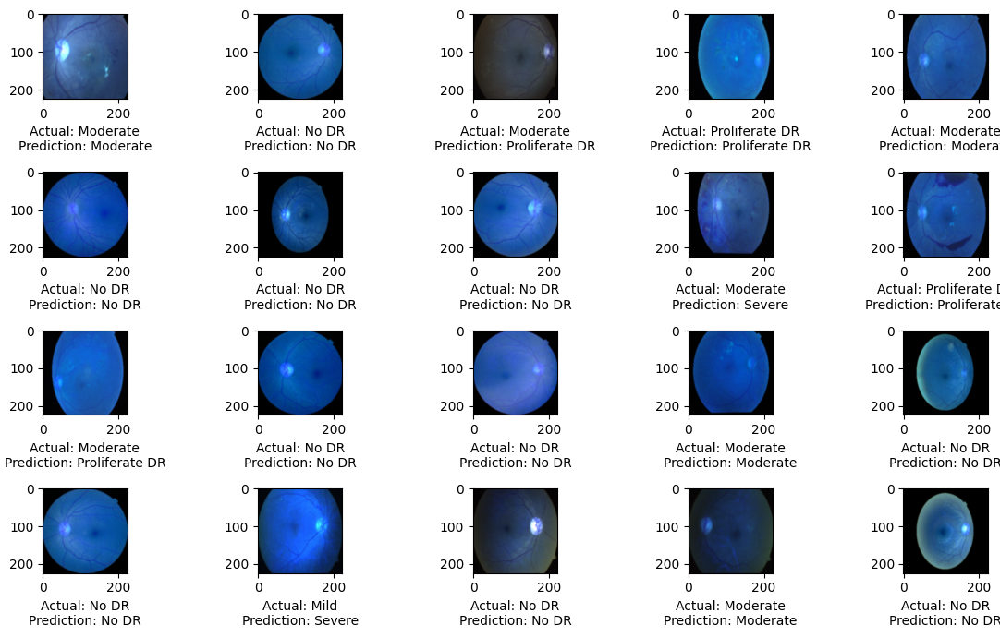

In [46]:
plt.figure(figsize=(12, 7))
for i in range(20):
    sample = random.choice(range(len(x_test)))
    image = x_test[sample]
    category = y_test[sample]
    pred_category = y_pred[sample]

    label_mapping = {
        0: "No DR",
        1: "Mild",
        2: "Moderate",
        3: "Severe",
        4: "Proliferate DR"
    }

    label = label_mapping[category]
    pred_label = label_mapping[pred_category]

    plt.subplot(4, 5, i + 1)
    plt.imshow(image)
    plt.xlabel("Actual: {}\nPrediction: {}".format(label, pred_label))
plt.tight_layout()
plt.show()

In [47]:
final_resnet50.save("DR_resnet50.h5")

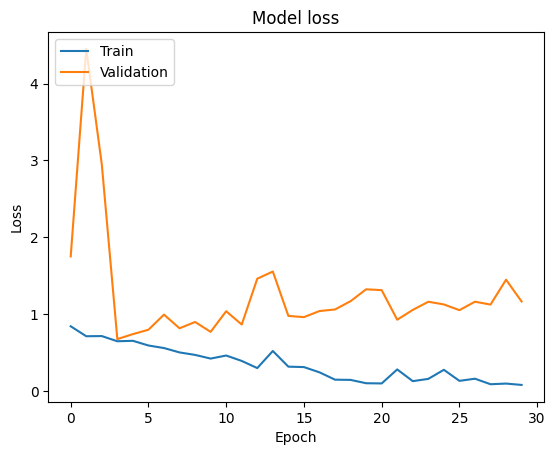

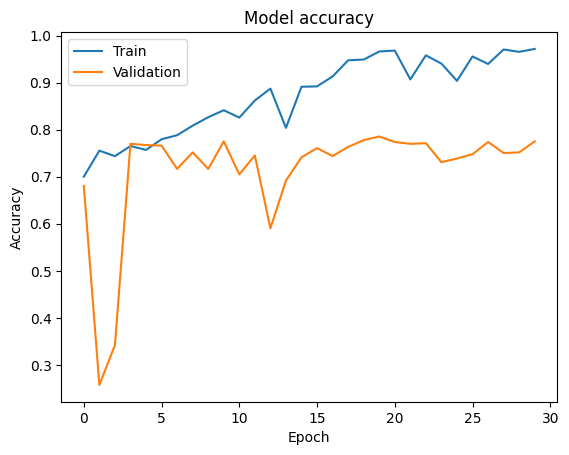

In [48]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()


plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

In [51]:

class_names = ['NO DR', 'MILD', 'MODERATE', 'SEVERE', 'PROLIFERATE']

y_pred = final_resnet50.predict(x_test)

y_pred_classes = np.argmax(y_pred, axis=1)

y_true_classes = y_test

report = classification_report(y_true_classes, y_pred_classes, target_names=class_names)
print(report)


11/11 ━━━━━━━━━━━━━━━━━━━━ 1s 80ms/step
              precision    recall  f1-score   support

       NO DR       0.95      0.98      0.96       151
        MILD       0.63      0.54      0.58        41
    MODERATE       0.62      0.72      0.67        83
      SEVERE       0.12      0.21      0.16        14
 PROLIFERATE       0.50      0.22      0.31        41

    accuracy                           0.73       330
   macro avg       0.56      0.53      0.53       330
weighted avg       0.74      0.73      0.73       330



In [53]:
conf_matrix = confusion_matrix(y_true_classes, y_pred_classes)

# Calculate per-class metrics
precision1 = precision_score(y_true_classes, y_pred_classes, average=None)
recall1 = recall_score(y_true_classes, y_pred_classes, average=None)
f11 = f1_score(y_true_classes, y_pred_classes, average=None)
mcc1 = matthews_corrcoef(y_true_classes, y_pred_classes)
kappa = cohen_kappa_score(y_true_classes, y_pred_classes)

# For specificity, we need to compute it manually
specificity1 = []
for i in range(conf_matrix.shape[0]):
    # True Negatives: sum all elements except the ith row and ith column
    tn = np.sum(np.delete(np.delete(conf_matrix, i, axis=0), i, axis=1))
    # False Positives: sum the ith column except the diagonal
    fp = np.sum(conf_matrix[:, i]) - conf_matrix[i, i]
    # False Negatives: sum the ith row except the diagonal
    fn = np.sum(conf_matrix[i, :]) - conf_matrix[i, i]
    # True Positives: diagonal element
    tp = conf_matrix[i, i]
    specificity1.append(tn / (tn + fp))

print(f"Precision per class: {precision1}")
print(f"Recall per class: {recall1}")
print(f"F1 Score per class: {f11}")
print(f"Specificity per class: {specificity1}")
print(f"Cohen's Kappa Score: {kappa}")
print(f"Matthews Correlation Coefficient (MCC): {mcc1}")

Precision per class: [0.94871795 0.62857143 0.6185567  0.125      0.5       ]
Recall per class: [0.98013245 0.53658537 0.72289157 0.21428571 0.2195122 ]
F1 Score per class: [0.96416938 0.57894737 0.66666667 0.15789474 0.30508475]
Specificity per class: [0.9553072625698324, 0.9550173010380623, 0.8502024291497976, 0.9335443037974683, 0.9688581314878892]
Cohen's Kappa Score: 0.6116816431322207
Matthews Correlation Coefficient (MCC): 0.6154223733629476


In [54]:
print(conf_matrix)

[[148   3   0   0   0]
 [  5  22  12   1   1]
 [  3   7  60   9   4]
 [  0   0   7   3   4]
 [  0   3  18  11   9]]


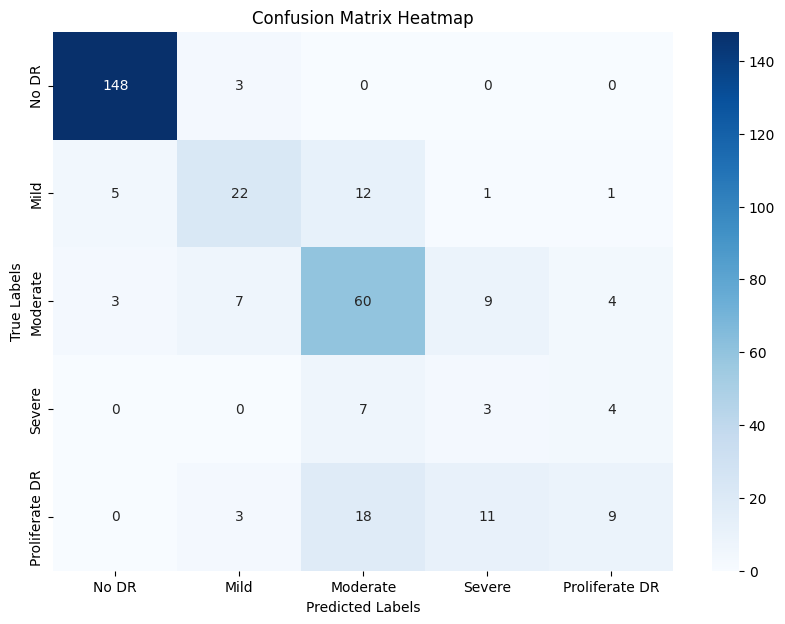

In [55]:
plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', 
            xticklabels=["No DR", "Mild", "Moderate", "Severe", "Proliferate DR"],
            yticklabels=["No DR", "Mild", "Moderate", "Severe", "Proliferate DR"])
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix Heatmap')
plt.show()

In [56]:
tp_list = []
tn_list = []
fp_list = []
fn_list = []

# Iterate over each class index
for i in range(conf_matrix.shape[0]):
    tp = conf_matrix[i, i]
    fp = np.sum(conf_matrix[:, i]) - tp
    fn = np.sum(conf_matrix[i, :]) - tp
    tn = np.sum(conf_matrix) - (tp + fp + fn)

    tp_list.append(tp)
    tn_list.append(tn)
    fp_list.append(fp)
    fn_list.append(fn)

print(f"True Positives per class: {tp_list}")
print(f"True Negatives per class: {tn_list}")
print(f"False Positives per class: {fp_list}")
print(f"False Negatives per class: {fn_list}")

True Positives per class: [148, 22, 60, 3, 9]
True Negatives per class: [171, 276, 210, 295, 280]
False Positives per class: [8, 13, 37, 21, 9]
False Negatives per class: [3, 19, 23, 11, 32]


In [57]:
for layer in final_resnet50.layers:
    output_shape = getattr(layer, 'output_shape', 'N/A')
    print(f"Layer Name: {layer.name}")

Layer Name: input_layer
Layer Name: conv1_pad
Layer Name: conv1_conv
Layer Name: conv1_bn
Layer Name: conv1_relu
Layer Name: pool1_pad
Layer Name: pool1_pool
Layer Name: conv2_block1_1_conv
Layer Name: conv2_block1_1_bn
Layer Name: conv2_block1_1_relu
Layer Name: conv2_block1_2_conv
Layer Name: conv2_block1_2_bn
Layer Name: conv2_block1_2_relu
Layer Name: conv2_block1_0_conv
Layer Name: conv2_block1_3_conv
Layer Name: conv2_block1_0_bn
Layer Name: conv2_block1_3_bn
Layer Name: conv2_block1_add
Layer Name: conv2_block1_out
Layer Name: conv2_block2_1_conv
Layer Name: conv2_block2_1_bn
Layer Name: conv2_block2_1_relu
Layer Name: conv2_block2_2_conv
Layer Name: conv2_block2_2_bn
Layer Name: conv2_block2_2_relu
Layer Name: conv2_block2_3_conv
Layer Name: conv2_block2_3_bn
Layer Name: conv2_block2_add
Layer Name: conv2_block2_out
Layer Name: conv2_block3_1_conv
Layer Name: conv2_block3_1_bn
Layer Name: conv2_block3_1_relu
Layer Name: conv2_block3_2_conv
Layer Name: conv2_block3_2_bn
Layer Na

# Resnet 101

In [33]:
resnet101= ResNet101(input_shape=(224,224,3), weights='imagenet', include_top=False)

171446536/171446536 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step


In [34]:
x = Flatten()(resnet101.output)

dense1 = Dense(64, kernel_initializer='he_uniform')(x)
act1 = Activation('relu')(dense1)

dense2 = Dense(128, kernel_initializer='he_uniform')(act1)
act2 = Activation('relu')(dense2)

dense3 = Dense(256, kernel_initializer='he_uniform')(act2)
act3 = Activation('relu')(dense3)

dense4 = Dense(128, kernel_initializer='he_uniform')(act3)
act4 = Activation('relu')(dense4)

dense5 = Dense(64, kernel_initializer='he_uniform')(act4)
act5 = Activation('relu')(dense5)

predictions = Dense(5, activation='softmax')(act5)

In [35]:
final_resnet101 = Model(inputs=resnet101.input, outputs=predictions)


In [36]:
final_resnet101.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_pad           │ (None, 230, 230,  │          0 │ input_layer[0][0] │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_conv (Conv2D) │ (None, 112, 112,  │      9,472 │ conv1_pad[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_bn            │ (None, 112, 112,  │        256 │ conv1_conv[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_relu          │ (None, 112, 112,  │          0 │ conv1_bn[0][0]    │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pad           │ (None, 114, 114,  │          0 │ conv1_relu[0][0]  │
│ (ZeroPadding2D)     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pool          │ (None, 56, 56,    │          0 │ pool1_pad[0][0]   │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_conv │ (None, 56, 56,    │      4,160 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_bn   │ (None, 56, 56,    │        256 │ conv2_block1_1_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_relu │ (None, 56, 56,    │          0 │ conv2_block1_1_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_conv │ (None, 56, 56,    │     36,928 │ conv2_block1_1_r… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_bn   │ (None, 56, 56,    │        256 │ conv2_block1_2_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_relu │ (None, 56, 56,    │          0 │ conv2_block1_2_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_conv │ (None, 56, 56,    │     16,640 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_conv │ (None, 56, 56,    │     16,640 │ conv2_block1_2_r… │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_bn   │ (None, 56, 56,    │      1,024 │ conv2_block1_0_c… │
│ (BatchNormalizatio… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_bn   │ (None, 56, 56,    │      1,024 │ conv2_block1_3_c

 Total params: 49,163,589 (187.54 MB)

 Trainable params: 49,058,245 (187.14 MB)

 Non-trainable params: 105,344 (411.50 KB)

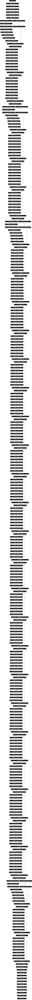

In [37]:
tf.keras.utils.plot_model(final_resnet101, show_shapes = True, show_layer_names=True)

In [38]:
final_resnet101.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

In [39]:
history = final_resnet101.fit(
    x_train,                # Training data
    y_train,                # Training labels
    validation_data=(x_val, y_val),  # Validation data and labels
    batch_size=32,
    epochs=30, 
    callbacks=[early_stopping_callback]
)

Epoch 1/30


I0000 00:00:1725289870.377411      89 service.cc:145] XLA service 0x798e54005d90 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1725289870.377461      89 service.cc:153]   StreamExecutor device (0): Tesla T4, Compute Capability 7.5
I0000 00:00:1725289870.377465      89 service.cc:153]   StreamExecutor device (1): Tesla T4, Compute Capability 7.5
I0000 00:00:1725289916.412740      89 asm_compiler.cc:369] ptxas warning : Registers are spilled to local memory in function 'loop_add_subtract_fusion_51', 40 bytes spill stores, 40 bytes spill loads

I0000 00:00:1725289916.485283      89 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


80/81 ━━━━━━━━━━━━━━━━━━━━ 0s 475ms/step - accuracy: 0.5874 - loss: 2.9212

I0000 00:00:1725289990.452698      89 asm_compiler.cc:369] ptxas warning : Registers are spilled to local memory in function 'loop_add_subtract_fusion_43', 40 bytes spill stores, 40 bytes spill loads
ptxas warning : Registers are spilled to local memory in function 'loop_add_subtract_fusion_42', 40 bytes spill stores, 40 bytes spill loads
ptxas warning : Registers are spilled to local memory in function 'input_add_reduce_fusion_99', 168 bytes spill stores, 168 bytes spill loads
ptxas warning : Registers are spilled to local memory in function 'input_reduce_fusion', 28 bytes spill stores, 28 bytes spill loads



81/81 ━━━━━━━━━━━━━━━━━━━━ 197s 1s/step - accuracy: 0.5890 - loss: 2.8862 - val_accuracy: 0.4876 - val_loss: 279006240.0000
Epoch 2/30
81/81 ━━━━━━━━━━━━━━━━━━━━ 45s 558ms/step - accuracy: 0.7150 - loss: 1.2197 - val_accuracy: 0.2692 - val_loss: 19441983488.0000
Epoch 3/30
81/81 ━━━━━━━━━━━━━━━━━━━━ 47s 583ms/step - accuracy: 0.6103 - loss: 1.2054 - val_accuracy: 0.4915 - val_loss: 687.2689
Epoch 4/30
81/81 ━━━━━━━━━━━━━━━━━━━━ 45s 560ms/step - accuracy: 0.7041 - loss: 0.8325 - val_accuracy: 0.6801 - val_loss: 1.5450
Epoch 5/30
81/81 ━━━━━━━━━━━━━━━━━━━━ 45s 558ms/step - accuracy: 0.6926 - loss: 0.8060 - val_accuracy: 0.7178 - val_loss: 0.7992
Epoch 6/30
81/81 ━━━━━━━━━━━━━━━━━━━━ 46s 564ms/step - accuracy: 0.7251 - loss: 0.7361 - val_accuracy: 0.7022 - val_loss: 0.8031
Epoch 7/30
81/81 ━━━━━━━━━━━━━━━━━━━━ 45s 560ms/step - accuracy: 0.7252 - loss: 0.7482 - val_accuracy: 0.6905 - val_loss: 0.8141
Epoch 8/30
81/81 ━━━━━━━━━━━━━━━━━━━━ 45s 560ms/step - accuracy: 0.7161 - loss: 0.7660 - v

In [40]:
train_loss, train_accuracy = final_resnet101.evaluate(x_train, y_train, verbose=0)
print(f"Training Accuracy: {train_accuracy * 100:.2f}%")

val_loss, val_accuracy = final_resnet101.evaluate(x_val, y_val, verbose=0)
print(f"Validation Accuracy: {val_accuracy * 100:.2f}%")

test_loss, test_accuracy = final_resnet101.evaluate(x_test, y_test, verbose=0)
print(f"Test Accuracy: {test_accuracy * 100:.2f}%")


Training Accuracy: 71.21%
Validation Accuracy: 66.84%
Test Accuracy: 68.48%


In [48]:
y_pred = []
for i in final_resnet101.predict(x_test):
    y_pred.append(np.argmax(np.array(i)).astype("int32"))

print(y_pred)

11/11 ━━━━━━━━━━━━━━━━━━━━ 2s 152ms/step
[4, 2, 0, 0, 0, 4, 0, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 0, 0, 0, 2, 1, 0, 0, 0, 2, 1, 0, 2, 0, 0, 3, 4, 1, 4, 0, 0, 2, 0, 2, 0, 4, 3, 0, 0, 1, 0, 0, 0, 0, 0, 4, 0, 0, 0, 2, 4, 0, 4, 4, 4, 0, 0, 4, 0, 0, 4, 2, 0, 1, 0, 4, 0, 1, 0, 1, 0, 4, 2, 0, 2, 3, 2, 0, 1, 0, 4, 4, 4, 4, 0, 2, 3, 0, 0, 0, 0, 4, 0, 1, 0, 0, 4, 0, 2, 0, 4, 2, 0, 1, 2, 0, 2, 1, 0, 4, 0, 0, 0, 1, 4, 4, 1, 0, 0, 0, 3, 2, 1, 0, 0, 2, 1, 3, 0, 0, 0, 1, 0, 4, 0, 0, 0, 0, 0, 0, 4, 3, 2, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 2, 2, 0, 4, 0, 2, 0, 0, 0, 0, 0, 0, 1, 0, 0, 2, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 2, 2, 4, 1, 3, 4, 0, 2, 1, 2, 0, 2, 0, 0, 2, 0, 0, 3, 2, 1, 0, 0, 4, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 3, 0, 0, 1, 4, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 4, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 4, 0, 0, 4, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 2, 0, 0, 1, 4, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 2, 1, 4, 4, 1, 0, 0, 0, 0, 1, 0, 0, 0, 2, 0, 0, 3, 0, 0, 0, 1, 1, 0, 0, 1, 2, 0, 1

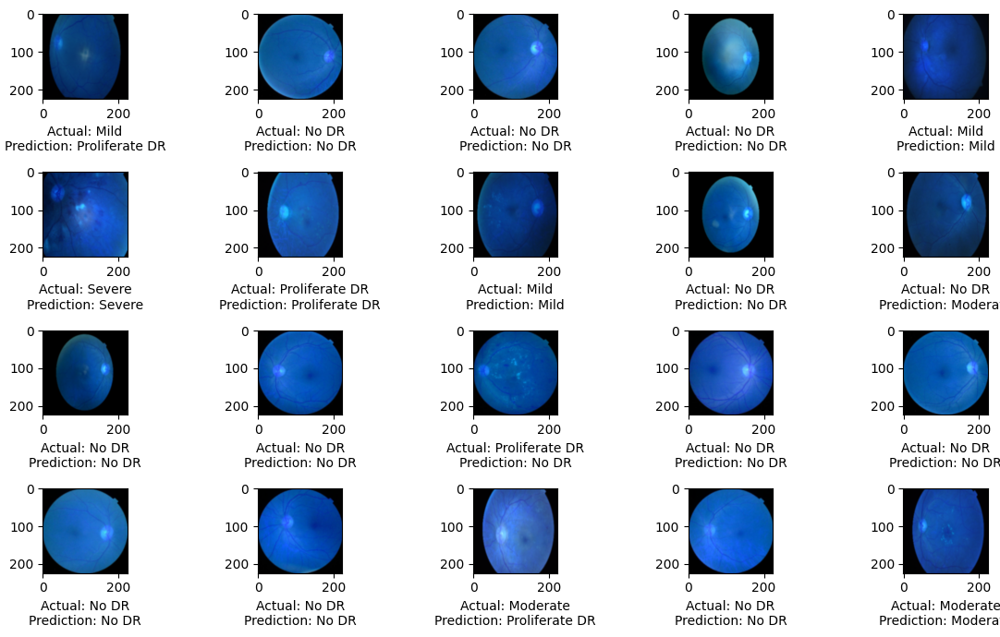

In [49]:
plt.figure(figsize=(12, 7))
for i in range(20):
    sample = random.choice(range(len(x_test)))
    image = x_test[sample]
    category = y_test[sample]
    pred_category = y_pred[sample]

    label_mapping = {
        0: "No DR",
        1: "Mild",
        2: "Moderate",
        3: "Severe",
        4: "Proliferate DR"
    }

    label = label_mapping[category]
    pred_label = label_mapping[pred_category]

    plt.subplot(4, 5, i + 1)
    plt.imshow(image)
    plt.xlabel("Actual: {}\nPrediction: {}".format(label, pred_label))
plt.tight_layout()
plt.show()

In [50]:
final_resnet101.save("DR_Resnet101.h5")

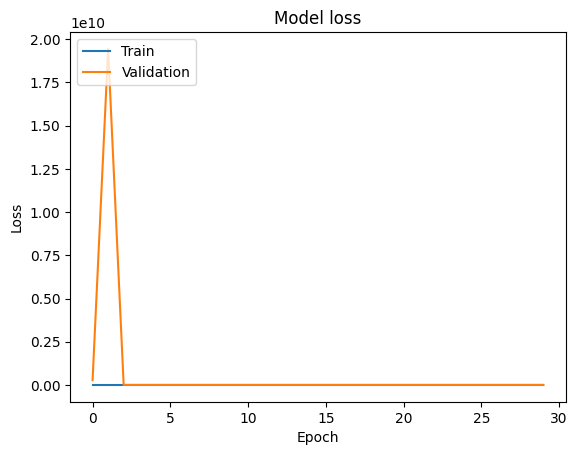

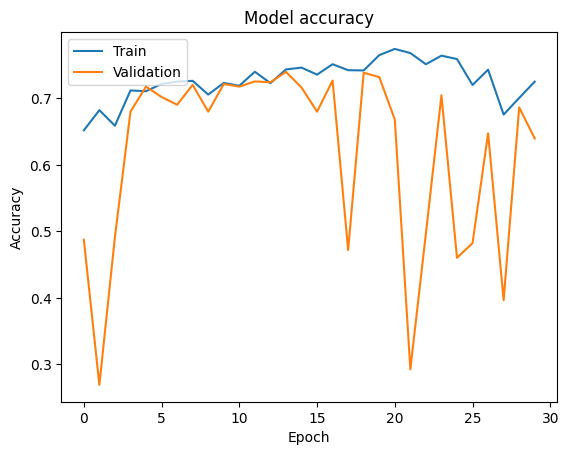

In [51]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()


plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

In [52]:

class_names = ['NO DR', 'MILD', 'MODERATE', 'SEVERE', 'PROLIFERATE']

y_pred = final_resnet101.predict(x_test)

y_pred_classes = np.argmax(y_pred, axis=1)

y_true_classes = y_test

report = classification_report(y_true_classes, y_pred_classes, target_names=class_names)
print(report)


11/11 ━━━━━━━━━━━━━━━━━━━━ 2s 153ms/step
              precision    recall  f1-score   support

       NO DR       0.89      0.94      0.91       179
        MILD       0.38      0.59      0.46        32
    MODERATE       0.69      0.31      0.43        88
      SEVERE       0.18      0.20      0.19        10
 PROLIFERATE       0.24      0.48      0.32        21

    accuracy                           0.68       330
   macro avg       0.48      0.50      0.46       330
weighted avg       0.72      0.68      0.68       330



In [53]:
conf_matrix = confusion_matrix(y_true_classes, y_pred_classes)

# Calculate per-class metrics
precision1 = precision_score(y_true_classes, y_pred_classes, average=None)
recall1 = recall_score(y_true_classes, y_pred_classes, average=None)
f11 = f1_score(y_true_classes, y_pred_classes, average=None)
mcc1 = matthews_corrcoef(y_true_classes, y_pred_classes)
kappa = cohen_kappa_score(y_true_classes, y_pred_classes)

# For specificity, we need to compute it manually
specificity1 = []
for i in range(conf_matrix.shape[0]):
    # True Negatives: sum all elements except the ith row and ith column
    tn = np.sum(np.delete(np.delete(conf_matrix, i, axis=0), i, axis=1))
    # False Positives: sum the ith column except the diagonal
    fp = np.sum(conf_matrix[:, i]) - conf_matrix[i, i]
    # False Negatives: sum the ith row except the diagonal
    fn = np.sum(conf_matrix[i, :]) - conf_matrix[i, i]
    # True Positives: diagonal element
    tp = conf_matrix[i, i]
    specificity1.append(tn / (tn + fp))

print(f"Precision per class: {precision1}")
print(f"Recall per class: {recall1}")
print(f"F1 Score per class: {f11}")
print(f"Specificity per class: {specificity1}")
print(f"Cohen's Kappa Score: {kappa}")
print(f"Matthews Correlation Coefficient (MCC): {mcc1}")

Precision per class: [0.88888889 0.38       0.69230769 0.18181818 0.24390244]
Recall per class: [0.93854749 0.59375    0.30681818 0.2        0.47619048]
F1 Score per class: [0.91304348 0.46341463 0.42519685 0.19047619 0.32258065]
Specificity per class: [0.8609271523178808, 0.8959731543624161, 0.9504132231404959, 0.971875, 0.8996763754045307]
Cohen's Kappa Score: 0.5030840066023803
Matthews Correlation Coefficient (MCC): 0.5151147603016188


In [54]:
print(conf_matrix)

[[168   6   4   0   1]
 [  4  19   3   2   4]
 [ 15  15  27   6  25]
 [  1   4   2   2   1]
 [  1   6   3   1  10]]


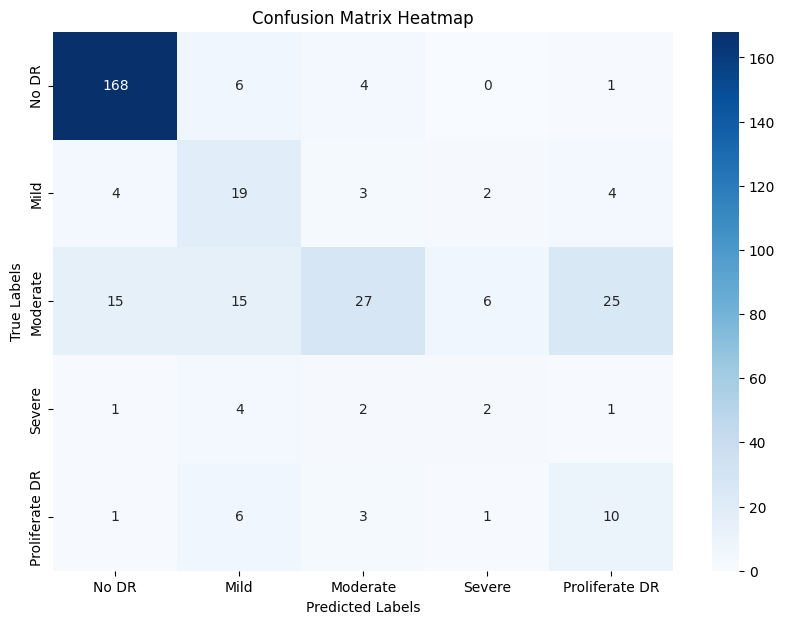

In [55]:
plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', 
            xticklabels=["No DR", "Mild", "Moderate", "Severe", "Proliferate DR"],
            yticklabels=["No DR", "Mild", "Moderate", "Severe", "Proliferate DR"])
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix Heatmap')
plt.show()

In [56]:
tp_list = []
tn_list = []
fp_list = []
fn_list = []

# Iterate over each class index
for i in range(conf_matrix.shape[0]):
    tp = conf_matrix[i, i]
    fp = np.sum(conf_matrix[:, i]) - tp
    fn = np.sum(conf_matrix[i, :]) - tp
    tn = np.sum(conf_matrix) - (tp + fp + fn)

    tp_list.append(tp)
    tn_list.append(tn)
    fp_list.append(fp)
    fn_list.append(fn)

print(f"True Positives per class: {tp_list}")
print(f"True Negatives per class: {tn_list}")
print(f"False Positives per class: {fp_list}")
print(f"False Negatives per class: {fn_list}")

True Positives per class: [168, 19, 27, 2, 10]
True Negatives per class: [130, 267, 230, 311, 278]
False Positives per class: [21, 31, 12, 9, 31]
False Negatives per class: [11, 13, 61, 8, 11]


In [57]:
for layer in final_resnet101.layers:
    output_shape = getattr(layer, 'output_shape', 'N/A')
    print(f"Layer Name: {layer.name}")

Layer Name: input_layer
Layer Name: conv1_pad
Layer Name: conv1_conv
Layer Name: conv1_bn
Layer Name: conv1_relu
Layer Name: pool1_pad
Layer Name: pool1_pool
Layer Name: conv2_block1_1_conv
Layer Name: conv2_block1_1_bn
Layer Name: conv2_block1_1_relu
Layer Name: conv2_block1_2_conv
Layer Name: conv2_block1_2_bn
Layer Name: conv2_block1_2_relu
Layer Name: conv2_block1_0_conv
Layer Name: conv2_block1_3_conv
Layer Name: conv2_block1_0_bn
Layer Name: conv2_block1_3_bn
Layer Name: conv2_block1_add
Layer Name: conv2_block1_out
Layer Name: conv2_block2_1_conv
Layer Name: conv2_block2_1_bn
Layer Name: conv2_block2_1_relu
Layer Name: conv2_block2_2_conv
Layer Name: conv2_block2_2_bn
Layer Name: conv2_block2_2_relu
Layer Name: conv2_block2_3_conv
Layer Name: conv2_block2_3_bn
Layer Name: conv2_block2_add
Layer Name: conv2_block2_out
Layer Name: conv2_block3_1_conv
Layer Name: conv2_block3_1_bn
Layer Name: conv2_block3_1_relu
Layer Name: conv2_block3_2_conv
Layer Name: conv2_block3_2_bn
Layer Na

# Mobile Net V2

In [33]:
mobilenet = MobileNetV2(input_shape=(224,224,3), weights='imagenet', include_top=False)

9406464/9406464 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


In [34]:
x = Flatten()(mobilenet.output)

dense1 = Dense(64, kernel_initializer='he_uniform')(x)
act1 = Activation('relu')(dense1)

dense2 = Dense(128, kernel_initializer='he_uniform')(act1)
act2 = Activation('relu')(dense2)

dense3 = Dense(256, kernel_initializer='he_uniform')(act2)
act3 = Activation('relu')(dense3)

dense4 = Dense(128, kernel_initializer='he_uniform')(act3)
act4 = Activation('relu')(dense4)

dense5 = Dense(64, kernel_initializer='he_uniform')(act4)
act5 = Activation('relu')(dense5)

predictions = Dense(5, activation='softmax')(act5)


In [35]:
final_mobilenet = Model(inputs=mobilenet.input, outputs=predictions)

In [36]:
final_mobilenet.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1 (Conv2D)      │ (None, 112, 112,  │        864 │ input_layer[0][0] │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bn_Conv1            │ (None, 112, 112,  │        128 │ Conv1[0][0]       │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1_relu (ReLU)   │ (None, 112, 112,  │          0 │ bn_Conv1[0][0]    │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        288 │ Conv1_relu[0][0]  │
│ (DepthwiseConv2D)   │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        128 │ expanded_conv_de… │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │          0 │ expanded_conv_de… │
│ (ReLU)              │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │        512 │ expanded_conv_de… │
│ (Conv2D)            │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │         64 │ expanded_conv_pr… │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand      │ (None, 112, 112,  │      1,536 │ expanded_conv_pr… │
│ (Conv2D)            │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_BN   │ (None, 112, 112,  │        384 │ block_1_expand[0… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_relu │ (None, 112, 112,  │          0 │ block_1_expand_B… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_pad         │ (None, 113, 113,  │          0 │ block_1_expand_r… │
│ (ZeroPadding2D)     │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise   │ (None, 56, 56,    │        864 │ block_1_pad[0][0] │
│ (DepthwiseConv2D)   │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 56, 56,    │        384 │ block_1_depthwis… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 56, 56,    │          0 │ block_1_depthwis… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_project     │ (None, 56, 56,    │      2,304 │ block_1_depthwis

 Total params: 6,354,949 (24.24 MB)

 Trainable params: 6,320,837 (24.11 MB)

 Non-trainable params: 34,112 (133.25 KB)

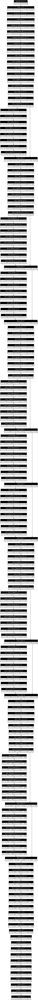

In [37]:
tf.keras.utils.plot_model(final_mobilenet, show_shapes = True, show_layer_names=True)

In [38]:
final_mobilenet.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

In [39]:
history = final_mobilenet.fit(
    x_train,                # Training data
    y_train,                # Training labels
    validation_data=(x_val, y_val),  # Validation data and labels
    batch_size=32,
    epochs=30, 
    callbacks=[early_stopping_callback]
)

Epoch 1/30


I0000 00:00:1725349695.896554     118 service.cc:145] XLA service 0x79bb3c004980 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1725349695.896619     118 service.cc:153]   StreamExecutor device (0): Tesla T4, Compute Capability 7.5
I0000 00:00:1725349695.896623     118 service.cc:153]   StreamExecutor device (1): Tesla T4, Compute Capability 7.5


 1/81 ━━━━━━━━━━━━━━━━━━━━ 1:07:52 51s/step - accuracy: 0.1875 - loss: 2.4979

I0000 00:00:1725349720.688942     118 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


81/81 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step - accuracy: 0.6081 - loss: 2.1351

I0000 00:00:1725349746.234391     118 asm_compiler.cc:369] ptxas warning : Registers are spilled to local memory in function 'input_reduce_fusion_1', 248 bytes spill stores, 248 bytes spill loads
ptxas warning : Registers are spilled to local memory in function 'input_reduce_fusion_2', 24 bytes spill stores, 24 bytes spill loads
ptxas warning : Registers are spilled to local memory in function 'input_and_reduce_fusion', 284 bytes spill stores, 292 bytes spill loads
ptxas warning : Registers are spilled to local memory in function 'loop_add_subtract_fusion_16', 56 bytes spill stores, 56 bytes spill loads



81/81 ━━━━━━━━━━━━━━━━━━━━ 83s 401ms/step - accuracy: 0.6092 - loss: 2.1231 - val_accuracy: 0.4824 - val_loss: 124.1540
Epoch 2/30
81/81 ━━━━━━━━━━━━━━━━━━━━ 8s 103ms/step - accuracy: 0.7651 - loss: 0.9078 - val_accuracy: 0.4824 - val_loss: 58.9533
Epoch 3/30
81/81 ━━━━━━━━━━━━━━━━━━━━ 8s 103ms/step - accuracy: 0.7506 - loss: 0.6823 - val_accuracy: 0.4824 - val_loss: 31.0246
Epoch 4/30
81/81 ━━━━━━━━━━━━━━━━━━━━ 8s 104ms/step - accuracy: 0.7738 - loss: 0.6575 - val_accuracy: 0.0767 - val_loss: 33.8963
Epoch 5/30
81/81 ━━━━━━━━━━━━━━━━━━━━ 8s 103ms/step - accuracy: 0.7971 - loss: 0.5576 - val_accuracy: 0.5176 - val_loss: 10.1819
Epoch 6/30
81/81 ━━━━━━━━━━━━━━━━━━━━ 8s 103ms/step - accuracy: 0.6749 - loss: 1.2357 - val_accuracy: 0.4824 - val_loss: 13.0971
Epoch 7/30
81/81 ━━━━━━━━━━━━━━━━━━━━ 8s 103ms/step - accuracy: 0.7014 - loss: 0.8181 - val_accuracy: 0.4824 - val_loss: 5.1057
Epoch 8/30
81/81 ━━━━━━━━━━━━━━━━━━━━ 8s 103ms/step - accuracy: 0.7668 - loss: 0.6577 - val_accuracy: 0.254

In [40]:
train_loss, train_accuracy = final_mobilenet.evaluate(x_train, y_train, verbose=0)
print(f"Training Accuracy: {train_accuracy * 100:.2f}%")

val_loss, val_accuracy = final_mobilenet.evaluate(x_val, y_val, verbose=0)
print(f"Validation Accuracy: {val_accuracy * 100:.2f}%")

test_loss, test_accuracy = final_mobilenet.evaluate(x_test, y_test, verbose=0)
print(f"Test Accuracy: {test_accuracy * 100:.2f}%")


Training Accuracy: 50.49%
Validation Accuracy: 48.50%
Test Accuracy: 47.88%


In [41]:
y_pred = []
for i in final_mobilenet.predict(x_test):
    y_pred.append(np.argmax(np.array(i)).astype("int32"))

print(y_pred)

11/11 ━━━━━━━━━━━━━━━━━━━━ 6s 295ms/step
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

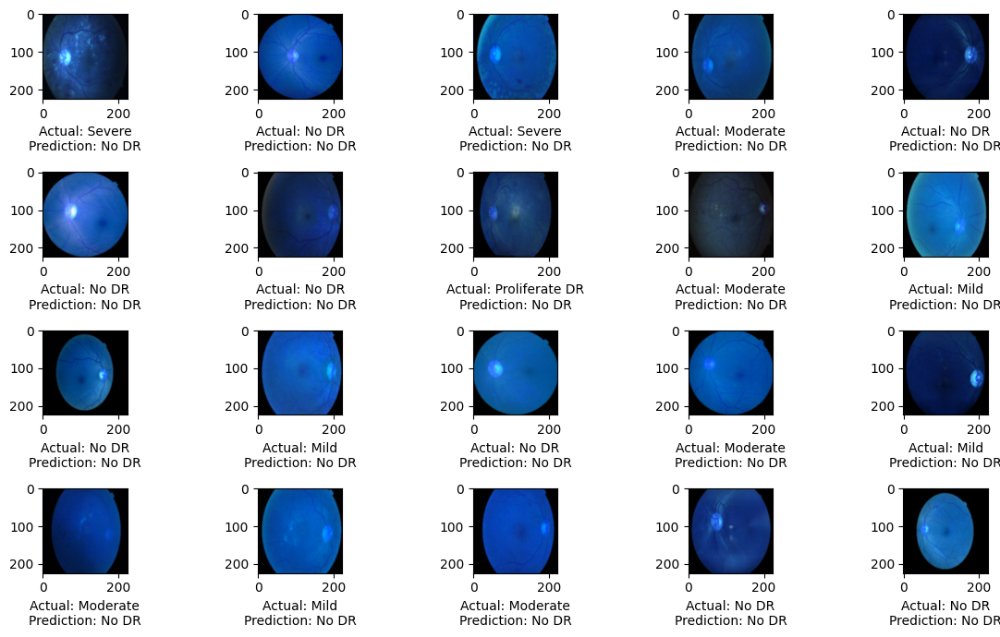

In [42]:
plt.figure(figsize=(12, 7))
for i in range(20):
    sample = random.choice(range(len(x_test)))
    image = x_test[sample]
    category = y_test[sample]
    pred_category = y_pred[sample]

    label_mapping = {
        0: "No DR",
        1: "Mild",
        2: "Moderate",
        3: "Severe",
        4: "Proliferate DR"
    }

    label = label_mapping[category]
    pred_label = label_mapping[pred_category]

    plt.subplot(4, 5, i + 1)
    plt.imshow(image)
    plt.xlabel("Actual: {}\nPrediction: {}".format(label, pred_label))
plt.tight_layout()
plt.show()

In [44]:
final_mobilenet.save("DR_mobilenet.h5")

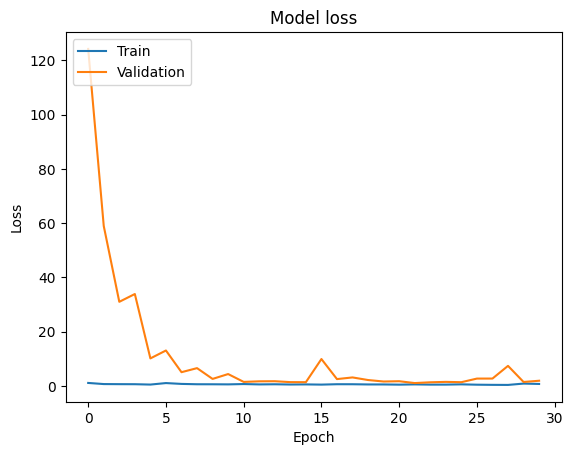

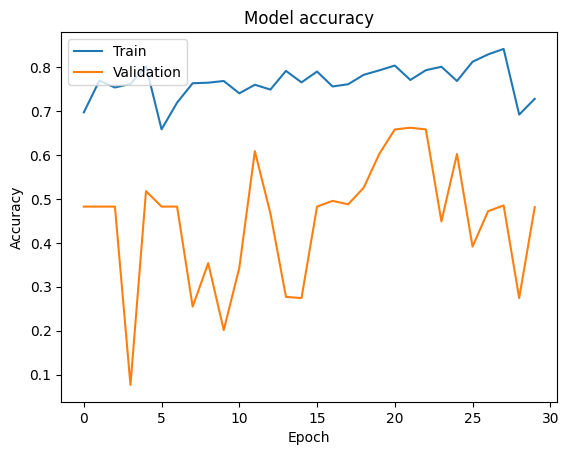

In [45]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()


plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

In [46]:

class_names = ['NO DR', 'MILD', 'MODERATE', 'SEVERE', 'PROLIFERATE']

y_pred = final_mobilenet.predict(x_test)

y_pred_classes = np.argmax(y_pred, axis=1)

y_true_classes = y_test

report = classification_report(y_true_classes, y_pred_classes, target_names=class_names)
print(report)


11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
              precision    recall  f1-score   support

       NO DR       0.48      1.00      0.65       155
        MILD       0.17      0.03      0.06        29
    MODERATE       0.67      0.02      0.04       100
      SEVERE       0.00      0.00      0.00        23
 PROLIFERATE       0.00      0.00      0.00        23

    accuracy                           0.48       330
   macro avg       0.26      0.21      0.15       330
weighted avg       0.44      0.48      0.32       330



/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [47]:
conf_matrix = confusion_matrix(y_true_classes, y_pred_classes)

# Calculate per-class metrics
precision1 = precision_score(y_true_classes, y_pred_classes, average=None)
recall1 = recall_score(y_true_classes, y_pred_classes, average=None)
f11 = f1_score(y_true_classes, y_pred_classes, average=None)
mcc1 = matthews_corrcoef(y_true_classes, y_pred_classes)
kappa = cohen_kappa_score(y_true_classes, y_pred_classes)

# For specificity, we need to compute it manually
specificity1 = []
for i in range(conf_matrix.shape[0]):
    # True Negatives: sum all elements except the ith row and ith column
    tn = np.sum(np.delete(np.delete(conf_matrix, i, axis=0), i, axis=1))
    # False Positives: sum the ith column except the diagonal
    fp = np.sum(conf_matrix[:, i]) - conf_matrix[i, i]
    # False Negatives: sum the ith row except the diagonal
    fn = np.sum(conf_matrix[i, :]) - conf_matrix[i, i]
    # True Positives: diagonal element
    tp = conf_matrix[i, i]
    specificity1.append(tn / (tn + fp))

print(f"Precision per class: {precision1}")
print(f"Recall per class: {recall1}")
print(f"F1 Score per class: {f11}")
print(f"Specificity per class: {specificity1}")
print(f"Cohen's Kappa Score: {kappa}")
print(f"Matthews Correlation Coefficient (MCC): {mcc1}")

Precision per class: [0.48286604 0.16666667 0.66666667 0.         0.        ]
Recall per class: [1.         0.03448276 0.02       0.         0.        ]
F1 Score per class: [0.6512605  0.05714286 0.03883495 0.         0.        ]
Specificity per class: [0.05142857142857143, 0.9833887043189369, 0.9956521739130435, 1.0, 1.0]
Cohen's Kappa Score: 0.03257145779004966
Matthews Correlation Coefficient (MCC): 0.0927754663106433


/opt/conda/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [48]:
print(conf_matrix)

[[155   0   0   0   0]
 [ 28   1   0   0   0]
 [ 94   4   2   0   0]
 [ 22   0   1   0   0]
 [ 22   1   0   0   0]]


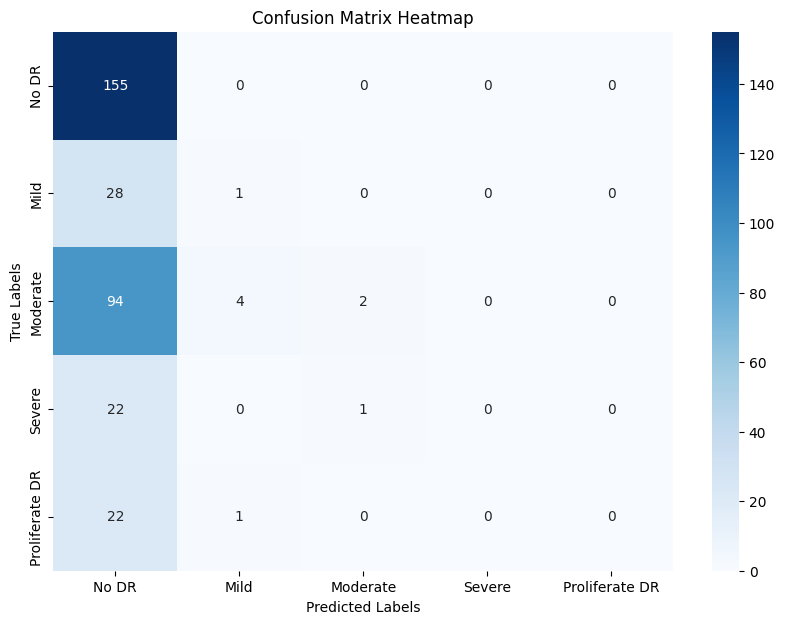

In [49]:
plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', 
            xticklabels=["No DR", "Mild", "Moderate", "Severe", "Proliferate DR"],
            yticklabels=["No DR", "Mild", "Moderate", "Severe", "Proliferate DR"])
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix Heatmap')
plt.show()

In [50]:
tp_list = []
tn_list = []
fp_list = []
fn_list = []

# Iterate over each class index
for i in range(conf_matrix.shape[0]):
    tp = conf_matrix[i, i]
    fp = np.sum(conf_matrix[:, i]) - tp
    fn = np.sum(conf_matrix[i, :]) - tp
    tn = np.sum(conf_matrix) - (tp + fp + fn)

    tp_list.append(tp)
    tn_list.append(tn)
    fp_list.append(fp)
    fn_list.append(fn)

print(f"True Positives per class: {tp_list}")
print(f"True Negatives per class: {tn_list}")
print(f"False Positives per class: {fp_list}")
print(f"False Negatives per class: {fn_list}")

True Positives per class: [155, 1, 2, 0, 0]
True Negatives per class: [9, 296, 229, 307, 307]
False Positives per class: [166, 5, 1, 0, 0]
False Negatives per class: [0, 28, 98, 23, 23]


In [51]:
for layer in final_mobilenet.layers:
    output_shape = getattr(layer, 'output_shape', 'N/A')
    print(f"Layer Name: {layer.name}")

Layer Name: input_layer
Layer Name: Conv1
Layer Name: bn_Conv1
Layer Name: Conv1_relu
Layer Name: expanded_conv_depthwise
Layer Name: expanded_conv_depthwise_BN
Layer Name: expanded_conv_depthwise_relu
Layer Name: expanded_conv_project
Layer Name: expanded_conv_project_BN
Layer Name: block_1_expand
Layer Name: block_1_expand_BN
Layer Name: block_1_expand_relu
Layer Name: block_1_pad
Layer Name: block_1_depthwise
Layer Name: block_1_depthwise_BN
Layer Name: block_1_depthwise_relu
Layer Name: block_1_project
Layer Name: block_1_project_BN
Layer Name: block_2_expand
Layer Name: block_2_expand_BN
Layer Name: block_2_expand_relu
Layer Name: block_2_depthwise
Layer Name: block_2_depthwise_BN
Layer Name: block_2_depthwise_relu
Layer Name: block_2_project
Layer Name: block_2_project_BN
Layer Name: block_2_add
Layer Name: block_3_expand
Layer Name: block_3_expand_BN
Layer Name: block_3_expand_relu
Layer Name: block_3_pad
Layer Name: block_3_depthwise
Layer Name: block_3_depthwise_BN
Layer Name:

# InceptionResNetV2


In [33]:
inception = InceptionResNetV2(input_shape=(224,224,3), weights='imagenet', include_top=False)

219055592/219055592 ━━━━━━━━━━━━━━━━━━━━ 6s 0us/step


In [34]:
x = inception.output
flat = Flatten()(x)

dense1 = Dense(64, kernel_initializer='he_uniform')(flat)
act1 = Activation('relu')(dense1)

dense2 = Dense(128, kernel_initializer='he_uniform')(act1)
act2 = Activation('relu')(dense2)

dense3 = Dense(256, kernel_initializer='he_uniform')(act2)
act3 = Activation('relu')(dense3)

dense4 = Dense(128, kernel_initializer='he_uniform')(act3)
act4 = Activation('relu')(dense4)

dense5 = Dense(64, kernel_initializer='he_uniform')(act4)
act5 = Activation('relu')(dense5)

predictions = Dense(5, activation='softmax')(act5)


In [35]:
final_inception = Model(inputs=inception.input,outputs=predictions)

In [36]:
final_inception.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d (Conv2D)     │ (None, 111, 111,  │        864 │ input_layer[0][0] │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalization │ (None, 111, 111,  │         96 │ conv2d[0][0]      │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation          │ (None, 111, 111,  │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1 (Conv2D)   │ (None, 109, 109,  │      9,216 │ activation[0][0]  │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 109, 109,  │         96 │ conv2d_1[0][0]    │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_1        │ (None, 109, 109,  │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_2 (Conv2D)   │ (None, 109, 109,  │     18,432 │ activation_1[0][… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 109, 109,  │        192 │ conv2d_2[0][0]    │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_2        │ (None, 109, 109,  │          0 │ batch_normalizat… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d       │ (None, 54, 54,    │          0 │ activation_2[0][… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_3 (Conv2D)   │ (None, 54, 54,    │      5,120 │ max_pooling2d[0]… │
│                     │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 54, 54,    │        240 │ conv2d_3[0][0]    │
│ (BatchNormalizatio… │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_3        │ (None, 54, 54,    │          0 │ batch_normalizat… │
│ (Activation)        │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_4 (Conv2D)   │ (None, 52, 52,    │    138,240 │ activation_3[0][… │
│                     │ 192)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 52, 52,    │        576 │ conv2d_4[0][0]    │
│ (BatchNormalizatio… │ 192)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_4        │ (None, 52, 52,    │          0 │ batch_normalizat

 Total params: 56,877,221 (216.97 MB)

 Trainable params: 56,816,677 (216.74 MB)

 Non-trainable params: 60,544 (236.50 KB)

In [37]:
tf.keras.utils.plot_model(final_inception, show_shapes = True, show_layer_names=True)

In [38]:
final_inception.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

In [39]:
history = final_inception.fit(
    x_train,                # Training data
    y_train,                # Training labels
    validation_data=(x_val, y_val),  # Validation data and labels
    batch_size=32,
    epochs=30, 
    callbacks=[early_stopping_callback]
)

Epoch 1/30


I0000 00:00:1725357257.519666     117 service.cc:145] XLA service 0x7c7eb4002690 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1725357257.519726     117 service.cc:153]   StreamExecutor device (0): Tesla T4, Compute Capability 7.5
I0000 00:00:1725357257.519731     117 service.cc:153]   StreamExecutor device (1): Tesla T4, Compute Capability 7.5
I0000 00:00:1725357342.071234     117 asm_compiler.cc:369] ptxas warning : Registers are spilled to local memory in function 'loop_add_subtract_fusion_108', 28 bytes spill stores, 28 bytes spill loads
ptxas warning : Registers are spilled to local memory in function 'loop_add_subtract_fusion_107', 40 bytes spill stores, 40 bytes spill loads

I0000 00:00:1725357342.192164     117 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


80/81 ━━━━━━━━━━━━━━━━━━━━ 0s 503ms/step - accuracy: 0.5360 - loss: 1.6429

I0000 00:00:1725357441.781705     114 asm_compiler.cc:369] ptxas warning : Registers are spilled to local memory in function 'input_reduce_fusion', 72 bytes spill stores, 72 bytes spill loads
ptxas warning : Registers are spilled to local memory in function 'input_reduce_fusion_1', 16 bytes spill stores, 16 bytes spill loads
ptxas warning : Registers are spilled to local memory in function 'loop_add_subtract_fusion_122', 28 bytes spill stores, 28 bytes spill loads
ptxas warning : Registers are spilled to local memory in function 'loop_add_subtract_fusion_121', 40 bytes spill stores, 40 bytes spill loads



81/81 ━━━━━━━━━━━━━━━━━━━━ 293s 2s/step - accuracy: 0.5382 - loss: 1.6323 - val_accuracy: 0.6008 - val_loss: 4.1121
Epoch 2/30
81/81 ━━━━━━━━━━━━━━━━━━━━ 46s 565ms/step - accuracy: 0.6804 - loss: 0.9629 - val_accuracy: 0.5449 - val_loss: 177.9455
Epoch 3/30
81/81 ━━━━━━━━━━━━━━━━━━━━ 43s 529ms/step - accuracy: 0.7553 - loss: 0.6859 - val_accuracy: 0.5826 - val_loss: 81.5248
Epoch 4/30
81/81 ━━━━━━━━━━━━━━━━━━━━ 43s 534ms/step - accuracy: 0.7660 - loss: 0.6523 - val_accuracy: 0.7711 - val_loss: 0.6192
Epoch 5/30
81/81 ━━━━━━━━━━━━━━━━━━━━ 43s 532ms/step - accuracy: 0.7756 - loss: 0.5753 - val_accuracy: 0.7867 - val_loss: 0.5898
Epoch 6/30
81/81 ━━━━━━━━━━━━━━━━━━━━ 43s 534ms/step - accuracy: 0.7965 - loss: 0.5383 - val_accuracy: 0.7217 - val_loss: 0.7830
Epoch 7/30
81/81 ━━━━━━━━━━━━━━━━━━━━ 43s 529ms/step - accuracy: 0.7563 - loss: 0.6538 - val_accuracy: 0.7815 - val_loss: 0.6693
Epoch 8/30
81/81 ━━━━━━━━━━━━━━━━━━━━ 43s 535ms/step - accuracy: 0.8148 - loss: 0.4918 - val_accuracy: 0.73

In [41]:
train_loss, train_accuracy = final_inception.evaluate(x_train, y_train, verbose=0)
print(f"Training Accuracy: {train_accuracy * 100:.2f}%")

val_loss, val_accuracy = final_inception.evaluate(x_val, y_val, verbose=0)
print(f"Validation Accuracy: {val_accuracy * 100:.2f}%")

test_loss, test_accuracy = final_inception.evaluate(x_test, y_test, verbose=0)
print(f"Test Accuracy: {test_accuracy * 100:.2f}%")

Training Accuracy: 98.21%
Validation Accuracy: 75.81%
Test Accuracy: 74.85%


In [42]:
y_pred = []
for i in final_inception.predict(x_test):
    y_pred.append(np.argmax(np.array(i)).astype("int32"))

print(y_pred)

11/11 ━━━━━━━━━━━━━━━━━━━━ 21s 1s/step 
[0, 1, 1, 2, 0, 0, 0, 2, 0, 1, 0, 2, 2, 2, 4, 0, 2, 0, 0, 0, 2, 0, 0, 2, 2, 4, 1, 0, 2, 0, 2, 0, 2, 4, 0, 0, 0, 0, 0, 4, 0, 0, 2, 2, 0, 3, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 2, 0, 2, 4, 0, 2, 0, 2, 0, 4, 4, 2, 4, 2, 2, 2, 4, 0, 0, 2, 0, 2, 0, 0, 2, 0, 3, 0, 4, 2, 2, 1, 3, 0, 1, 2, 0, 4, 1, 1, 2, 0, 2, 0, 1, 0, 1, 0, 0, 0, 0, 1, 2, 2, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 3, 0, 1, 0, 0, 2, 4, 0, 1, 0, 4, 1, 2, 0, 2, 1, 2, 0, 2, 4, 1, 0, 0, 0, 0, 3, 2, 3, 0, 0, 2, 2, 2, 2, 0, 0, 0, 1, 0, 3, 0, 0, 2, 0, 1, 2, 0, 2, 2, 2, 1, 0, 4, 2, 0, 3, 0, 2, 2, 1, 0, 1, 2, 1, 3, 0, 0, 0, 3, 3, 0, 2, 2, 0, 4, 2, 2, 2, 2, 2, 0, 0, 1, 0, 0, 0, 1, 0, 2, 0, 1, 1, 0, 0, 2, 0, 0, 0, 0, 0, 4, 2, 2, 1, 2, 4, 3, 1, 1, 2, 1, 2, 0, 4, 0, 2, 0, 0, 2, 4, 2, 0, 2, 1, 2, 0, 4, 2, 2, 2, 0, 0, 2, 4, 1, 1, 0, 1, 2, 0, 2, 2, 0, 2, 0, 0, 2, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 2, 1, 1, 0, 0, 2, 0, 0, 2, 1, 0, 0, 2, 2, 2, 0, 0, 0, 0, 0, 2, 2, 0, 0, 1, 1, 1, 0, 2, 0, 2, 0, 0, 4, 0,

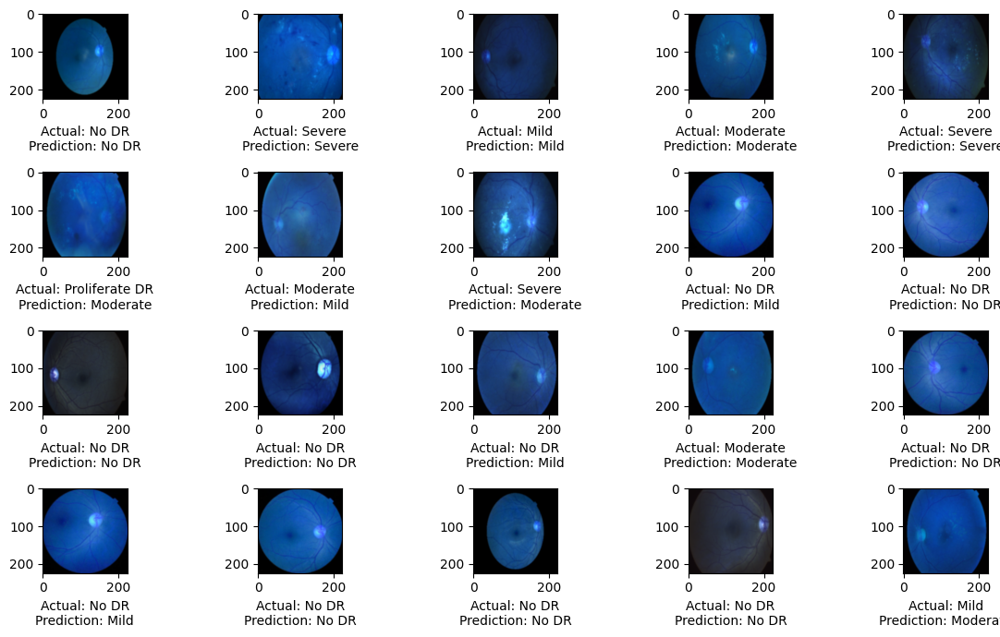

In [44]:
plt.figure(figsize=(12, 7))
for i in range(20):
    sample = random.choice(range(len(x_test)))
    image = x_test[sample]
    category = y_test[sample]
    pred_category = y_pred[sample]

    label_mapping = {
        0: "No DR",
        1: "Mild",
        2: "Moderate",
        3: "Severe",
        4: "Proliferate DR"
    }

    label = label_mapping[category]
    pred_label = label_mapping[pred_category]

    plt.subplot(4, 5, i + 1)
    plt.imshow(image)
    plt.xlabel("Actual: {}\nPrediction: {}".format(label, pred_label))
plt.tight_layout()
plt.show()

In [46]:
final_inception.save("DR_Inception.h5")

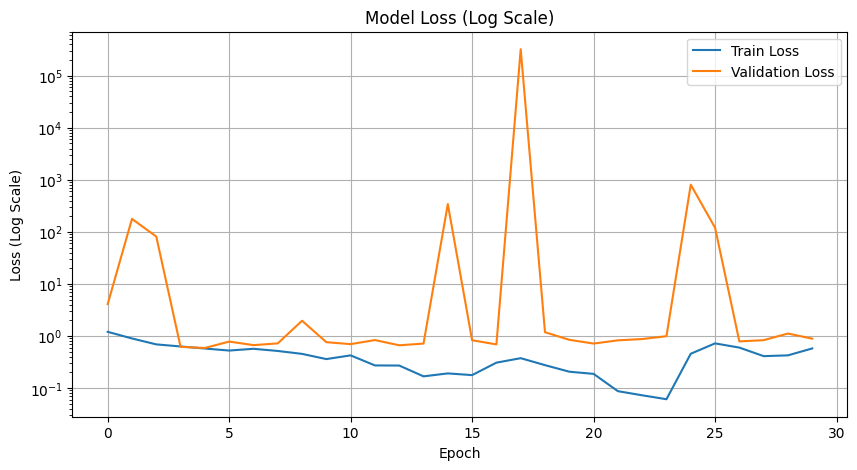

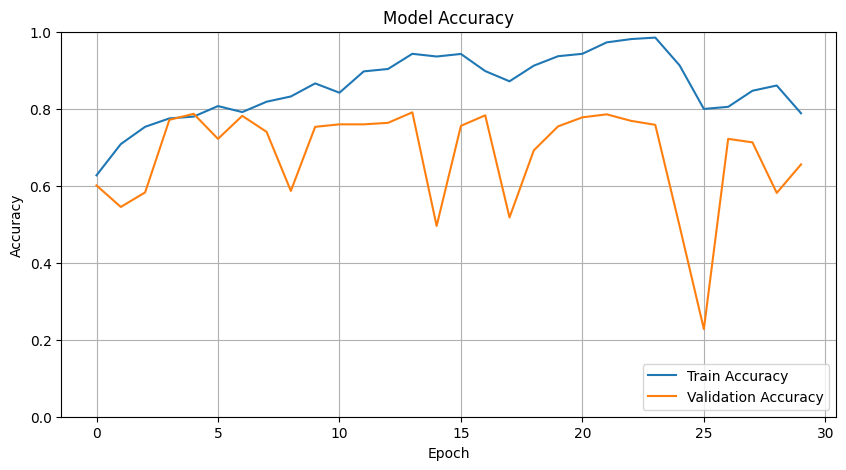

In [48]:
# Standardized Model Loss Plot
plt.figure(figsize=(10, 5))

plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.yscale('log')  # Use a logarithmic scale for better visualization if loss is too high
plt.title('Model Loss (Log Scale)')
plt.ylabel('Loss (Log Scale)')
plt.xlabel('Epoch')
plt.legend(loc='upper right')
plt.grid(True)  # Adds grid lines for better readability
plt.show()

# Standardized Model Accuracy Plot
plt.figure(figsize=(10, 5))

plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.ylim(0, 1)  # Accuracy is between 0 and 1
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(loc='lower right')
plt.grid(True)
plt.show()


In [49]:
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score

class_names = ['NO DR', 'MILD', 'MODERATE', 'SEVERE', 'PROLIFERATE']

y_pred = final_inception.predict(x_test)

y_pred_classes = np.argmax(y_pred, axis=1)

y_true_classes = y_test

report = classification_report(y_true_classes, y_pred_classes, target_names=class_names)
print(report)


11/11 ━━━━━━━━━━━━━━━━━━━━ 1s 140ms/step
              precision    recall  f1-score   support

       NO DR       0.99      0.91      0.95       164
        MILD       0.41      0.59      0.49        32
    MODERATE       0.64      0.72      0.68        86
      SEVERE       0.42      0.22      0.29        23
 PROLIFERATE       0.48      0.44      0.46        25

    accuracy                           0.75       330
   macro avg       0.59      0.58      0.57       330
weighted avg       0.76      0.75      0.75       330



In [50]:
conf_matrix = confusion_matrix(y_true_classes, y_pred_classes)

# Calculate per-class metrics
precision1 = precision_score(y_true_classes, y_pred_classes, average=None)
recall1 = recall_score(y_true_classes, y_pred_classes, average=None)
f11 = f1_score(y_true_classes, y_pred_classes, average=None)
mcc1 = matthews_corrcoef(y_true_classes, y_pred_classes)
kappa = cohen_kappa_score(y_true_classes, y_pred_classes)

# For specificity, we need to compute it manually
specificity1 = []
for i in range(conf_matrix.shape[0]):
    # True Negatives: sum all elements except the ith row and ith column
    tn = np.sum(np.delete(np.delete(conf_matrix, i, axis=0), i, axis=1))
    # False Positives: sum the ith column except the diagonal
    fp = np.sum(conf_matrix[:, i]) - conf_matrix[i, i]
    # False Negatives: sum the ith row except the diagonal
    fn = np.sum(conf_matrix[i, :]) - conf_matrix[i, i]
    # True Positives: diagonal element
    tp = conf_matrix[i, i]
    specificity1.append(tn / (tn + fp))

print(f"Precision per class: {precision1}")
print(f"Recall per class: {recall1}")
print(f"F1 Score per class: {f11}")
print(f"Specificity per class: {specificity1}")
print(f"Cohen's Kappa Score: {kappa}")
print(f"Matthews Correlation Coefficient (MCC): {mcc1}")

Precision per class: [0.98684211 0.41304348 0.63917526 0.41666667 0.47826087]
Recall per class: [0.91463415 0.59375    0.72093023 0.2173913  0.44      ]
F1 Score per class: [0.94936709 0.48717949 0.67759563 0.28571429 0.45833333]
Specificity per class: [0.9879518072289156, 0.9093959731543624, 0.8565573770491803, 0.9771986970684039, 0.9606557377049181]
Cohen's Kappa Score: 0.626365831366718
Matthews Correlation Coefficient (MCC): 0.6288995103823415


In [51]:
print(conf_matrix)

[[150  12   2   0   0]
 [  1  19  12   0   0]
 [  1  11  62   4   8]
 [  0   2  12   5   4]
 [  0   2   9   3  11]]


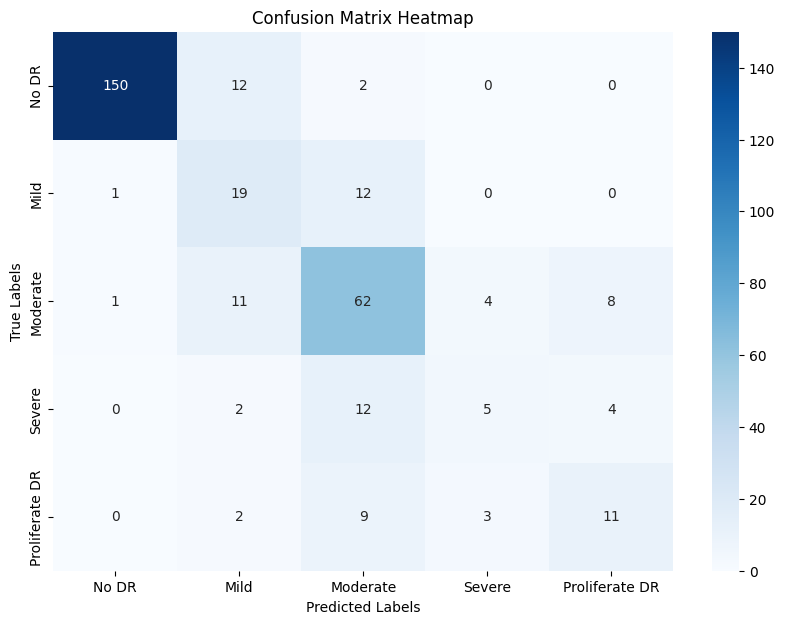

In [52]:
plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', 
            xticklabels=["No DR", "Mild", "Moderate", "Severe", "Proliferate DR"],
            yticklabels=["No DR", "Mild", "Moderate", "Severe", "Proliferate DR"])
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix Heatmap')
plt.show()

In [53]:
tp_list = []
tn_list = []
fp_list = []
fn_list = []

# Iterate over each class index
for i in range(conf_matrix.shape[0]):
    tp = conf_matrix[i, i]
    fp = np.sum(conf_matrix[:, i]) - tp
    fn = np.sum(conf_matrix[i, :]) - tp
    tn = np.sum(conf_matrix) - (tp + fp + fn)

    tp_list.append(tp)
    tn_list.append(tn)
    fp_list.append(fp)
    fn_list.append(fn)

print(f"True Positives per class: {tp_list}")
print(f"True Negatives per class: {tn_list}")
print(f"False Positives per class: {fp_list}")
print(f"False Negatives per class: {fn_list}")

True Positives per class: [150, 19, 62, 5, 11]
True Negatives per class: [164, 271, 209, 300, 293]
False Positives per class: [2, 27, 35, 7, 12]
False Negatives per class: [14, 13, 24, 18, 14]


In [54]:
for layer in final_inception.layers:
    output_shape = getattr(layer, 'output_shape', 'N/A')
    print(f"Layer Name: {layer.name}")

Layer Name: input_layer
Layer Name: conv2d
Layer Name: batch_normalization
Layer Name: activation
Layer Name: conv2d_1
Layer Name: batch_normalization_1
Layer Name: activation_1
Layer Name: conv2d_2
Layer Name: batch_normalization_2
Layer Name: activation_2
Layer Name: max_pooling2d
Layer Name: conv2d_3
Layer Name: batch_normalization_3
Layer Name: activation_3
Layer Name: conv2d_4
Layer Name: batch_normalization_4
Layer Name: activation_4
Layer Name: max_pooling2d_1
Layer Name: conv2d_8
Layer Name: batch_normalization_8
Layer Name: activation_8
Layer Name: conv2d_6
Layer Name: conv2d_9
Layer Name: batch_normalization_6
Layer Name: batch_normalization_9
Layer Name: activation_6
Layer Name: activation_9
Layer Name: average_pooling2d
Layer Name: conv2d_5
Layer Name: conv2d_7
Layer Name: conv2d_10
Layer Name: conv2d_11
Layer Name: batch_normalization_5
Layer Name: batch_normalization_7
Layer Name: batch_normalization_10
Layer Name: batch_normalization_11
Layer Name: activation_5
Layer Nam